<a href="https://colab.research.google.com/github/checheanya/expression_modelling/blob/main/part2/Expression_modelling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Imports

We have to install GillesPy2 package that we will work with later. Please, restart the runtime after the package instalation.

In [1]:
!python3 -m pip install gillespy2 --user --upgrade
# restart the runtime!

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 398.7/398.7 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 65.1 MB/s eta 0:00:00
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


In [1]:
import os
import sys
import numpy as np
import pandas as pd
import pickle

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import plotly.express as px

from scipy.stats import pearsonr, zipf, weibull_min, beta, expon
from scipy.integrate import odeint, solve_ivp
from sklearn.preprocessing import MinMaxScaler

import gillespy2

In [ ]:
# if this is google colab:
from google.colab import files

In [2]:
sns.set_theme(style="darkgrid")

## Trying out different ODE solvers

There are several avaliable solvers that can handle systems of ODE equations in Python. Below I am comparing `odeint` and `solve_ivp` functions:



In [ ]:
def full_eq0(t, z, kon, koff, phi, s, delta):
	A, I, x = z # initial conditions?
	return [kon*I - koff*A, koff*A - kon*I, phi*s*A - delta*x]

t = np.linspace(0,5)
z0 = (1, 0, 10)
args = (1, 1, 10, 1, 1)

In [ ]:
%%time
# method 1
sol = solve_ivp(fun = full_eq0, t_span = (0, 5), y0 = z0,
                args = args)

CPU times: user 2.9 ms, sys: 0 ns, total: 2.9 ms
Wall time: 2.91 ms


In [ ]:
sol.y.shape

(3, 11)

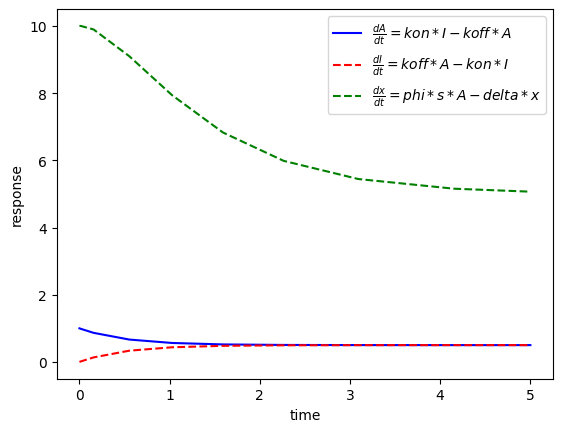

In [ ]:
plt.plot(sol.t,sol.y[0],'b-',label=r'$\frac{dA}{dt}= kon*I - koff*A$')
plt.plot(sol.t,sol.y[1],'r--',label=r'$\frac{dI}{dt}= koff*A - kon*I$')
plt.plot(sol.t,sol.y[2],'g--',label=r'$\frac{dx}{dt}= phi*s*A - delta*x$')
plt.ylabel('response')
plt.xlabel('time')
plt.legend(loc='best')
plt.show()

In [ ]:
# method 2

def full_eq0(z, t, kon, koff, phi, s, delta):	# t and z in different order
	A, I, x = z # initial conditions?
	return [kon*I - koff*A, koff*A - kon*I, phi*s*A - delta*x]

In [ ]:
%%time
z = odeint(func = full_eq0, y0 = z0, t = t, args = args)

CPU times: user 1.01 ms, sys: 0 ns, total: 1.01 ms
Wall time: 1.02 ms


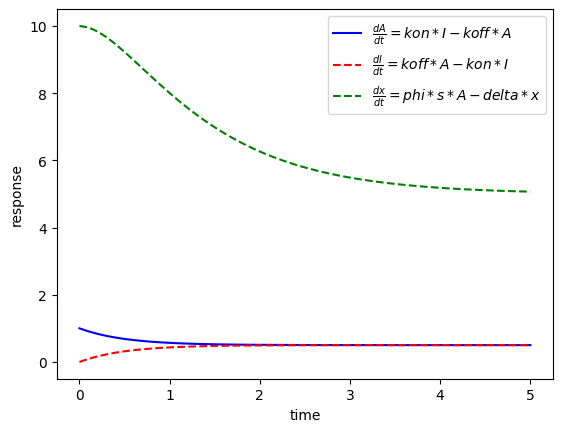

In [ ]:
# plotting
plt.plot(t,z[:,0],'b-',label=r'$\frac{dA}{dt}= kon*I - koff*A$')
plt.plot(t,z[:,1],'r--',label=r'$\frac{dI}{dt}= koff*A - kon*I$')
plt.plot(t,z[:,2],'g--',label=r'$\frac{dx}{dt}= phi*s*A - delta*x$')
plt.ylabel('response')
plt.xlabel('time')
plt.legend(loc='best')
plt.show()

Second method is faster! We will consider using it for the further deterministic solutions. <br>

## Using GillesPy

Here and below we will use [GillesPy2](https://github.com/StochSS/GillesPy2) Python library to formulate the model and to perform continuous and stochastic simulations.

GillesPy is a python module with predefined classes for different compositional elements needed for building a model and for different solvers. Here we will use ODE and SSA solvers both with C++ backend, since they showed the better performance.

First step of the modelling is to define a model. Below you can see definitions for initial embryological model from [Piras et al.](https://www.nature.com/articles/srep07137):

$$InactPromoter ↔ ActPromoter → x + ActPromoter$$
$$ x → ∅$$

$$\begin{cases}
dA_i(t)/dt = k_{on,i}I_i(t) - k_{off,i}A_i(t) \\
dI_i(t)/dt = k_{off,i}A_i(t) - k_{on,i}I_i(t) \\
dx_i(t)/dt = \phi_i s_i A_i(t) - \delta_i x_i(t)
\end{cases}$$

### Initial embryological model

To start we will use the following initial values:
* 1000 as initial concentration of RNA molecules (x)
* 10 as initial concentration of promotor in active and inactive state
* 0.5 for for reaction rates
* 100 for amplification constant $\phi$
* 0.05 for the decay constant

In [ ]:

def create_transcr_model0(parameter_values=None):

    # Instantiate Model
    model = gillespy2.Model(name="eq0")

    # Define Variables (GillesPy2.Species)
    active = gillespy2.Species(name='A', initial_value=10)
    inactive = gillespy2.Species(name='I', initial_value=10)
    rna = gillespy2.Species(name='x', initial_value=1000)

    # Add Variables to Model
    model.add_species([active, inactive, rna])

    # Define Parameters
    kon = gillespy2.Parameter(name='kon', expression=0.5)
    koff = gillespy2.Parameter(name='koff', expression=0.5)
    phi = gillespy2.Parameter(name='phi', expression=100)
    #s = gillespy2.Parameter(name='s', expression=10)
    delta = gillespy2.Parameter(name='delta', expression=0.05)

    # Add Parameters to Model
    model.add_parameter([kon, koff, phi, delta])

    # Define Reactions
    act = gillespy2.Reaction(
        name="activation", rate='kon', reactants={'I': 1}, products={'A':1}
    )
    inact = gillespy2.Reaction(
        name="inactivation", rate='koff', reactants={'A': 1}, products={'I':1}
    )
    transcr_ampl = gillespy2.Reaction(
        name="transcription", rate='phi', reactants={'A': 1}, products={'x':1, 'A':1}
    )
    #ampl = gillespy2.Reaction(
    #    name="amplification", rate='phi', reactants={'x': 1}, products={}
    #)
    decay = gillespy2.Reaction(
        name="decay", rate='delta', reactants={'x': 1}, products={}
    )

    # Add Reactions to Model
    model.add_reaction([act, inact, transcr_ampl, decay])

    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)

    # Set Model Timespan
    model.timespan(tspan)
    return model

After defining a model we need to initialize it:

In [ ]:
# Instantiate the Model
model = create_transcr_model0()

Once we have a defined model with all reaction we need, we can run simulations using different algorithms defined in GillesPy2 suite:

In [ ]:
ode_results = model.run(algorithm="ODE")
ssa_results = model.run(algorithm="SSA")
tau_results = model.run(algorithm="Tau-Leaping")
hybrid_results = model.run(algorithm="Tau-Hybrid")

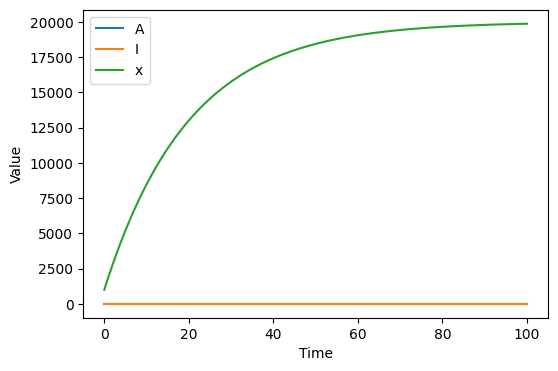

In [ ]:
ode_results.plot(figsize=(6, 4))

If we plot simulation by SSA algorithm, we can observe that the mean values are similar to what we see in deterministic simulation but now we have high level of noise:

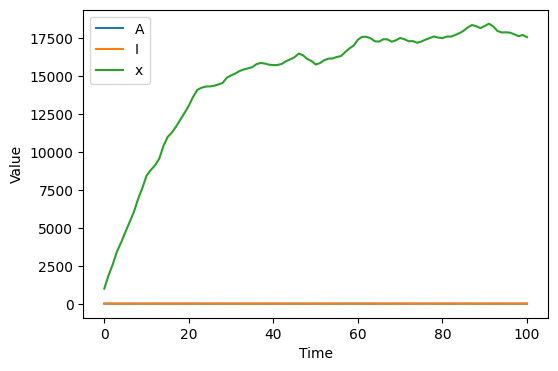

In [ ]:
ssa_results.plot(figsize=(6, 4))

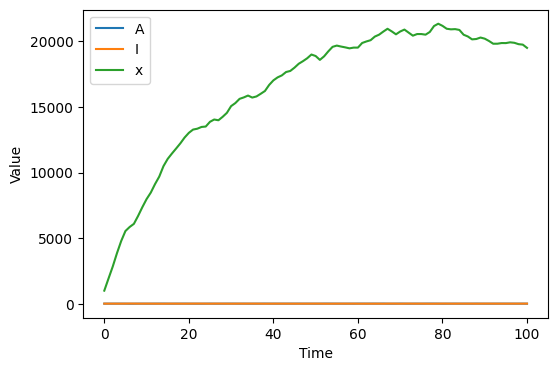

In [ ]:
tau_results.plot(figsize=(6, 4))

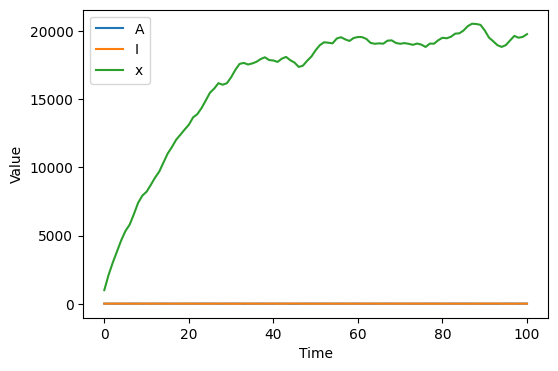

In [ ]:
hybrid_results.plot(figsize=(6, 4))

We can run simulation 1000 times and plot mean and sd for results:

In [ ]:
solverSSAC = gillespy2.SSACSolver(model)
res = model.run(solver=solverSSAC, number_of_trajectories=1000)

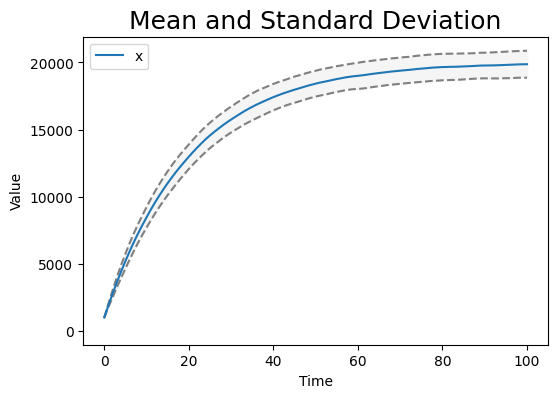

In [ ]:
res.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'])

Steady state (terminal point) deistribution:

In [ ]:
x = []
for i in res:
    x.append(i['x'][-1])

(array([  3.,  21.,  69., 130., 240., 235., 164.,  89.,  44.,   5.]),
 array([16645. , 17267.4, 17889.8, 18512.2, 19134.6, 19757. , 20379.4,
        21001.8, 21624.2, 22246.6, 22869. ]),
 <BarContainer object of 10 artists>)

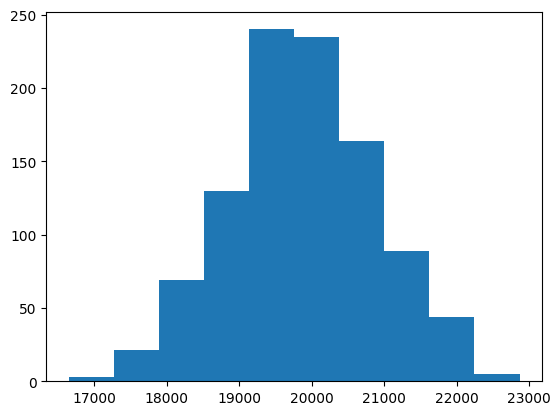

In [ ]:
plt.hist(x)

### Example of the model when we have ODE trajectory different from SSA

Since we want to benefit somehow from stochasticity, it is important to understand which properties should model have in order to perform differently under ODE and SSA.

Birth-death model is a simple example how SSA and ODE results may differ. Some stochastic event can lead to increase of product which will cause subsequent increase. Model definition:

In [ ]:

def birth_death_model(parameter_values=None):
    # Instantiate Model
    model = gillespy2.Model(name="b")
    # Define Variables (GillesPy2.Species)
    population = gillespy2.Species(name='N', initial_value=10)
    # Add Variables to Model
    model.add_species([population])
    # Define Parameters
    b = gillespy2.Parameter(name='birth_rate', expression=0.7)
    d = gillespy2.Parameter(name='death_rate', expression=0.3)
    # Add Parameters to Model
    model.add_parameter([b, d])
    # Define Reactions
    birth = gillespy2.Reaction(
        name="birth",  propensity_function="birth_rate*N", reactants={'N': 1}, products={'N':2}
    )
    death = gillespy2.Reaction(
        name="death",  propensity_function="-death_rate*N", reactants={'N': 1}, products={}
    )
    # Add Reactions to Model
    model.add_reaction([birth, death])
    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)
    # Set Model Timespan
    model.timespan(tspan)
    return model

Performing simulation:

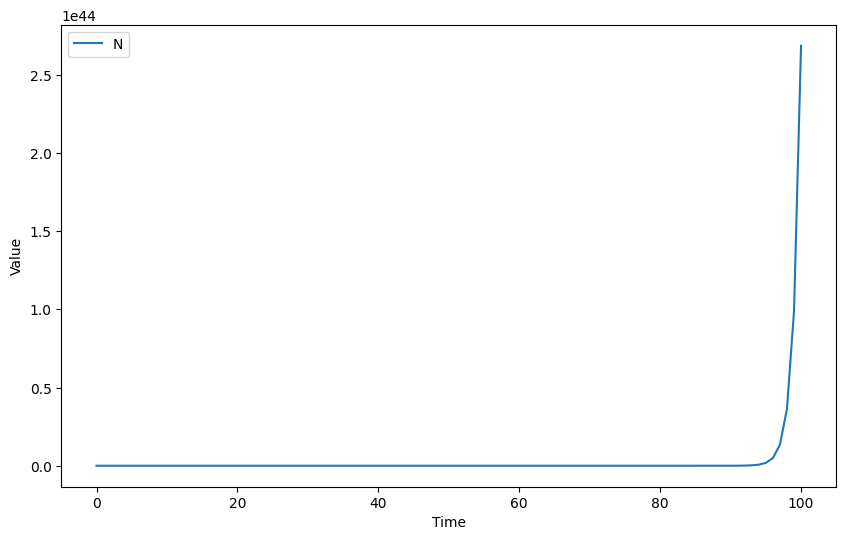

In [ ]:
model = birth_death_model()
ode_results = model.run(algorithm="ODE")
ssa_results = model.run(algorithm="SSA")
ode_results.plot(figsize=(10, 6))

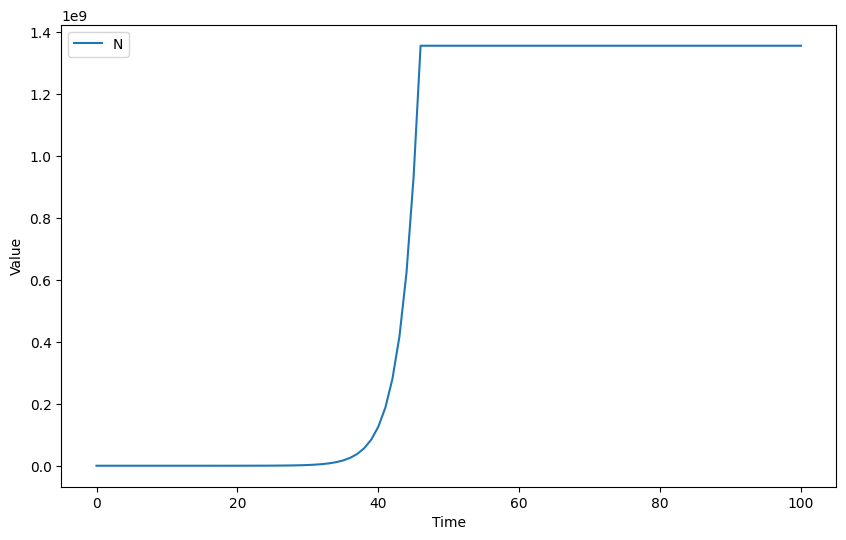

In [ ]:
ssa_results.plot(figsize=(10, 6))

It was an overflow here, but we can still see that the growth started way earlier for SSA than for ODE simulation.

### Creating the model based on regions and TF binding

Now we will create our main model. THe model consist of the species and reactions that can be divided into several groups of events:

1. **Open-closed states** transition for Promoter, Enhancer, Silencer

2. **TFs binding** and unbinding to Promoter, Enhancer, Silencer → complex formation

3. [Enhancer + TF] + **[Promoter + TF] complexes interaction** <br>
[Silencer + TF] + [Promoter + TF] complexes interaction <br>
→ here we consider chromatin remodelling and mediator proteins attraction to regulatory regions

4. Once [Enhancer + TF] + [Promoter + TF] supercomplex is formed, **transcription** is increased in addition to the base level from open promoter (if that's the case)

Things to consider later:
1. We can assume certain level of cooperativity OR interaction of TFs within the same pull of molecules for enhancer and silencer. We can model is as GRN (gene regulatory network) from which we can yeild affect on regulatory regions.  

2. The white Gaussian noise will be included later.

3. We can include $(A*TF)^n$ here - autoregulatory enhancer activation, $n$ - adjustable number of molecules (same could be done for silencer). This is creating a switch effect, so we will have two most frequent states of trancription instead of smooth gradient from lower level of transcription to higher.

4. We can introduce translation reactions and thus effect of the newly translated proteinson regulatory elemnts in the form of negative/positive feedback loop.

Please, consult the paper or presentation for the full description of reactions.

The main equation is the one describing transcription. First, we have constantly low level of expression from open promotor (assumption). We can describe it with the following reaction: $P → x + P$, where x is RNA.

Besides this we are considernig activation and repression events in our model. Final actors will be [Enhancer-TF * Promoter-TF] complex for activation and [Silencer-TF * Promoter-TF] complex for repression. So we can model it as following:

$$[EnhTF] + [PromTF] → [EnhTF * PromTF] → x + [EnhTF * PromTF]$$
$$[SilTF * PromTF] → [SilTF] + [PromTF] → x + [SilTF * PromTF]$$

We also tried different ways of defining of transcriptional equations implicitly (see below).

The last reaction in our model is RNA decay:

$$x → ∅$$

All old parameters here will be the same as in the initial model, and the rest of parameters will be set as follows.
Concentrations:
* x = 1000
* all other simple components = 10
* all complexes = 0

Reaction rates:
we assume that binding/unbinding reactions happen way faster than transcription, reaching the quasi steady state almost immedeately after the change in reagents concentrations. Thus we will first try to set the our parameters to the following initial values and later will explore each one independently:
* TF binding/unbinding constrants = 50
* Complexes interaction constants = 10 (since it requires chromatin remodelling)
* Chromatin on/off constants equal = 0.5
* Constitutive expression constant $ktr_{const} = 100$
* Activation reaction constant $ktr_{act} = 10000$

Note that last two retes are reflecting how much mRNA will be produced from $PromTF$ complex (constitutive expression) and from $EnhTF-PromTF$ (activated expression). However, they cannot be interpreted in a way that $ktr_{const}$ mRNA molecules are produced in one activation event. There are two ways of modelling it: either change stechiometry to 1:N or increasing the reaction rate or the transription reaction. Here we employ the second approach because of its simplicity in implementation.

One more important factor is a concentration of complexes. If we assume that the reaction chain has already been running for some time, we need to set some initial concentrations to complexes. However, then these concentrations will add to the total pull of species-components, since $A_{total} = A_{free} + A_{bound}$. In both cases soon after the start of simulation, complexes' and their components' concentrations will reach the steady state according to reaction rates and input concentrations.

Here we will first explore the case when initial concentration of complexes is zero and later when it is non-zero.

In [3]:
def create_transcr_model1(parameter_values=None):

    model = gillespy2.Model(name="equation1")

    # ========================== SPECIES =================================
    # expression
    rna = gillespy2.Species(name='x', initial_value=1000)

    # enhancer
    enh_open = gillespy2.Species(name='enhO', initial_value=10)
    enh_closed = gillespy2.Species(name='enhC', initial_value=10)
    enh_tf = gillespy2.Species(name='enhTF', initial_value=10)
    enh_complex = gillespy2.Species(name='enhO_enhTF', initial_value=0)

    # silencer
    sil_open = gillespy2.Species(name='silO', initial_value=10)
    sil_closed = gillespy2.Species(name='silC', initial_value=10)
    sil_tf = gillespy2.Species(name='silTF', initial_value=10)
    sil_complex = gillespy2.Species(name='silO_silTF', initial_value=0)

    # promotor
    prom_open = gillespy2.Species(name='promO', initial_value=10)
    prom_closed = gillespy2.Species(name='promC', initial_value=10)
    prom_tf = gillespy2.Species(name='promTF', initial_value=10)
    prom_complex = gillespy2.Species(name='promO_promTF', initial_value=0)

    # interaction promotor - enhancer/silencer
    prom_sil_complex = gillespy2.Species(name='prom_sil_complex', initial_value=0)
    prom_enh_complex = gillespy2.Species(name='prom_enh_complex', initial_value=0)

    # Add Variables to Model
    model.add_species([enh_open, enh_closed, enh_tf, enh_complex,
                       sil_open, sil_closed, sil_tf, sil_complex,
                       prom_open, prom_closed, prom_tf, prom_complex,
                       prom_sil_complex, prom_enh_complex, rna])

    # ========================== REACTION RATES =================================
    # open-closed function
    kPon = gillespy2.Parameter(name='kPon', expression=0.5)
    kPoff = gillespy2.Parameter(name='kPoff', expression=0.5)
    kSon = gillespy2.Parameter(name='kSon', expression=0.5)
    kSoff = gillespy2.Parameter(name='kSoff', expression=0.5)
    kEon = gillespy2.Parameter(name='kEon', expression=0.5)
    kEoff = gillespy2.Parameter(name='kEoff', expression=0.5)

    # TF binding consts
    bindPTF = gillespy2.Parameter(name='bindPTF', expression=50)
    bindETF = gillespy2.Parameter(name='bindETF', expression=50)
    bindSTF = gillespy2.Parameter(name='bindSTF', expression=50)

    unbindPTF = gillespy2.Parameter(name='unbindPTF', expression=50)
    unbindETF = gillespy2.Parameter(name='unbindETF', expression=50)
    unbindSTF = gillespy2.Parameter(name='unbindSTF', expression=50)

    # complex interactions
    prom_enh_bind = gillespy2.Parameter(name='prom_enh_bind', expression=10)
    prom_sil_bind = gillespy2.Parameter(name='prom_sil_bind', expression=10)
    prom_enh_unbind = gillespy2.Parameter(name='prom_enh_unbind', expression=10)
    prom_sil_unbind = gillespy2.Parameter(name='prom_sil_unbind', expression=10)

    # amplification, degradation consts
    ktr_const = gillespy2.Parameter(name='ktr_const', expression=100)
    ktr_act = gillespy2.Parameter(name='ktr_act', expression=1000)

    delta = gillespy2.Parameter(name='delta', expression=0.05)

    # Add Parameters to Model
    model.add_parameter([kPon, kPoff, kSon, kSoff, kEon, kEoff,
                         bindPTF, bindETF, bindSTF, unbindPTF, unbindETF, unbindSTF,
                         prom_enh_bind, prom_sil_bind, prom_enh_unbind,
                         prom_sil_unbind, ktr_const, ktr_act, delta])

    ## ========================== REACTIONS =================================
    # open-closed
    Popening = gillespy2.Reaction(name="Popening", rate='kPon', reactants={'promC': 1}, products={'promO':1})
    Pclosing = gillespy2.Reaction(name="Pclosing", rate='kPoff', reactants={'promO': 1}, products={'promC':1})
    Eopening = gillespy2.Reaction(name="Eopening", rate='kEon', reactants={'enhC': 1}, products={'enhO':1})
    Eclosing = gillespy2.Reaction(name="Eclosing", rate='kEoff', reactants={'silO': 1}, products={'silC':1})
    Sopening = gillespy2.Reaction(name="Sopening", rate='kSon', reactants={'enhC': 1}, products={'enhO':1})
    Sclosing = gillespy2.Reaction(name="Sclosing", rate='kSoff', reactants={'enhO': 1}, products={'enhC':1})

    # enh/sil/prom and TFs interaction
    P_TF_binding = gillespy2.Reaction(name="P_TF_binding", rate='bindPTF',
                                      reactants={'promO': 1, 'promTF': 1}, products={'promO_promTF':1})
    E_TF_binding = gillespy2.Reaction(name="E_TF_binding", rate='bindETF',
                                      reactants={'enhO': 1, 'enhTF': 1}, products={'enhO_enhTF':1})
    S_TF_binding = gillespy2.Reaction(name="S_TF_binding", rate='bindSTF',
                                      reactants={'silO': 1, 'silTF': 1}, products={'silO_silTF':1})

    P_TF_unbinding = gillespy2.Reaction(name="P_TF_unbinding", rate='unbindPTF',
                                      reactants={'promO_promTF':1}, products={'promO': 1, 'promTF': 1})
    E_TF_unbinding = gillespy2.Reaction(name="E_TF_unbinding", rate='unbindETF',
                                      reactants={'enhO_enhTF':1}, products={'enhO': 1, 'enhTF': 1})
    S_TF_unbinding = gillespy2.Reaction(name="S_TF_unbinding", rate='unbindSTF',
                                      reactants={'silO_silTF':1}, products={'silO': 1, 'silTF': 1})

    # enh/sil and promotor interaction
    enh_prom_binding = gillespy2.Reaction(name="enh_prom_binding", rate='prom_enh_bind',
                                      reactants={'promO_promTF': 1, 'enhO_enhTF': 1}, products={'prom_enh_complex':1})
    sil_prom_binding = gillespy2.Reaction(name="sil_prom_binding", rate='prom_sil_bind',
                                      reactants={'promO_promTF': 1, 'silO_silTF': 1}, products={'prom_sil_complex':1})

    enh_prom_unbinding = gillespy2.Reaction(name="enh_prom_unbinding", rate='prom_enh_unbind',
                                      reactants={'prom_enh_complex':1}, products={'promO_promTF': 1, 'enhO_enhTF': 1})
    sil_prom_unbinding = gillespy2.Reaction(name="sil_prom_unbinding", rate='prom_sil_unbind',
                                      reactants={'prom_sil_complex':1}, products={'promO_promTF': 1, 'silO_silTF': 1})

    # transcription
    #transcr_base = gillespy2.Reaction(name="transcr_act", rate='phi', reactants={'promO': 1}, products={'x':1, 'promO':1})
    transcr_act = gillespy2.Reaction(
        name="transcr_act", rate='ktr_act', reactants={'prom_enh_complex': 1},
        products={'x':1, 'prom_enh_complex':1}
        )
    # basically includes transcription from just open promotor
    #transcr_sil = gillespy2.Reaction(
    #    name="transcr_sil", rate='phi', reactants={'silO_silTF': 1, 'promO_promTF': 1},
    #    products={'silO_silTF':1, 'promO_promTF':1, 'x':1}
    #    )
    transcr_sil = gillespy2.Reaction(
        name="transcr_sil", rate='ktr_const', reactants={'promO_promTF': 1},
        products={'promO_promTF':1, 'x':1}
        )

    decay = gillespy2.Reaction(name="decay", rate='delta', reactants={'x': 1}, products={})  # 3
    #transcr = gillespy2.Reaction(name="transcr_sil", reactants={},
                     #                products={'x':1}, propensity_function="phi * prom_enh_complex/prom_sil_complex")

    # Add Reactions to Model
    model.add_reaction([Popening, Pclosing, Eopening, Eclosing, Sopening, Sclosing,
                        P_TF_binding, E_TF_binding, S_TF_binding, P_TF_unbinding,
                        E_TF_unbinding, S_TF_unbinding, enh_prom_binding,
                        sil_prom_binding, enh_prom_unbinding, sil_prom_unbinding,
                        transcr_act, transcr_sil, decay])

    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)

    # Set Model Timespan
    model.timespan(tspan)
    return model


We can also manually define the equation to use for the final transcription reaction:

$$dx_i/dt = ktr_{const} * P_{open,i}TF_P + ktr_{act}  \frac{1+[E_{open,i}TF_E*P_{open,i}TF_P]}{1+[S_{open,i}TF_S*P_{open,i}TF_P]}) - \delta_i x_i$$

As you can note, meaning of $ktr_{act}$ and $ktr_{const}$ is different from the definition in the previous model. Here these constants represent multiplication factors not the rate constants.  

In [4]:
def create_transcr_model2(parameter_values=None):

    # Instantiate Model
    model = gillespy2.Model(name="equation2")

    # ========================== VARIABLES =================================
    # expression
    rna = gillespy2.Species(name='x', initial_value=1000)

    # enhancer
    enh_open = gillespy2.Species(name='enhO', initial_value=10)
    enh_closed = gillespy2.Species(name='enhC', initial_value=10)
    enh_tf = gillespy2.Species(name='enhTF', initial_value=10)
    enh_complex = gillespy2.Species(name='enhO_enhTF', initial_value=10)

    # silencer
    sil_open = gillespy2.Species(name='silO', initial_value=10)
    sil_closed = gillespy2.Species(name='silC', initial_value=10)
    sil_tf = gillespy2.Species(name='silTF', initial_value=10)
    sil_complex = gillespy2.Species(name='silO_silTF', initial_value=10)

    # promotor
    prom_open = gillespy2.Species(name='promO', initial_value=10)
    prom_closed = gillespy2.Species(name='promC', initial_value=10)
    prom_tf = gillespy2.Species(name='promTF', initial_value=10)
    prom_complex = gillespy2.Species(name='promO_promTF', initial_value=10)

    # interaction promotor - enhancer/silencer
    prom_sil_complex = gillespy2.Species(name='prom_sil_complex', initial_value=10)
    prom_enh_complex = gillespy2.Species(name='prom_enh_complex', initial_value=10)

    # Add Variables to Model
    model.add_species([enh_open, enh_closed, enh_tf, enh_complex,
                       sil_open, sil_closed, sil_tf, sil_complex,
                       prom_open, prom_closed, prom_tf, prom_complex,
                       prom_sil_complex, prom_enh_complex, rna])

    # ========================== PARAMETERS =================================
    # open-closed function
    kPon = gillespy2.Parameter(name='kPon', expression=0.5)
    kPoff = gillespy2.Parameter(name='kPoff', expression=0.5)
    kSon = gillespy2.Parameter(name='kSon', expression=0.5)
    kSoff = gillespy2.Parameter(name='kSoff', expression=0.5)
    kEon = gillespy2.Parameter(name='kEon', expression=0.5)
    kEoff = gillespy2.Parameter(name='kEoff', expression=0.5)

    # TF binding consts
    bindPTF = gillespy2.Parameter(name='bindPTF', expression=0.5)
    bindETF = gillespy2.Parameter(name='bindETF', expression=0.5)
    bindSTF = gillespy2.Parameter(name='bindSTF', expression=0.5)

    unbindPTF = gillespy2.Parameter(name='unbindPTF', expression=0.5)
    unbindETF = gillespy2.Parameter(name='unbindETF', expression=0.5)
    unbindSTF = gillespy2.Parameter(name='unbindSTF', expression=0.5)

    # complex interactions
    prom_enh_bind = gillespy2.Parameter(name='prom_enh_bind', expression=0.5)
    prom_sil_bind = gillespy2.Parameter(name='prom_sil_bind', expression=0.5)
    prom_enh_unbind = gillespy2.Parameter(name='prom_enh_unbind', expression=0.5)
    prom_sil_unbind = gillespy2.Parameter(name='prom_sil_unbind', expression=0.5)

    # amplification, degradation consts
    ktr_act = gillespy2.Parameter(name='ktr_act', expression=1000)
    ktr_const = gillespy2.Parameter(name='ktr_const', expression=100)
    delta = gillespy2.Parameter(name='delta', expression=0.05)

    # Add Parameters to Model
    model.add_parameter([kPon, kPoff, kSon, kSoff, kEon, kEoff,
                         bindPTF, bindETF, bindSTF, unbindPTF, unbindETF, unbindSTF,
                         prom_enh_bind, prom_sil_bind, prom_enh_unbind,
                         prom_sil_unbind, ktr_act, delta, ktr_const])

    ## ========================== REACTIONS =================================
    # open-closed
    Popening = gillespy2.Reaction(name="Popening", rate='kPon', reactants={'promC': 1}, products={'promO':1})
    Pclosing = gillespy2.Reaction(name="Pclosing", rate='kPoff', reactants={'promO': 1}, products={'promC':1})
    Eopening = gillespy2.Reaction(name="Eopening", rate='kEon', reactants={'enhC': 1}, products={'enhO':1})
    Eclosing = gillespy2.Reaction(name="Eclosing", rate='kEoff', reactants={'silO': 1}, products={'silC':1})
    Sopening = gillespy2.Reaction(name="Sopening", rate='kSon', reactants={'enhC': 1}, products={'enhO':1})
    Sclosing = gillespy2.Reaction(name="Sclosing", rate='kSoff', reactants={'enhO': 1}, products={'enhC':1})

    # enh/sil/prom and TFs interaction
    P_TF_binding = gillespy2.Reaction(name="P_TF_binding", rate='bindPTF',
                                      reactants={'promO': 1, 'promTF': 1}, products={'promO_promTF':1})
    E_TF_binding = gillespy2.Reaction(name="E_TF_binding", rate='bindETF',
                                      reactants={'enhO': 1, 'enhTF': 1}, products={'enhO_enhTF':1})
    S_TF_binding = gillespy2.Reaction(name="S_TF_binding", rate='bindSTF',
                                      reactants={'silO': 1, 'silTF': 1}, products={'silO_silTF':1})

    P_TF_unbinding = gillespy2.Reaction(name="P_TF_unbinding", rate='unbindPTF',
                                      reactants={'promO_promTF':1}, products={'promO': 1, 'promTF': 1})
    E_TF_unbinding = gillespy2.Reaction(name="E_TF_unbinding", rate='unbindETF',
                                      reactants={'enhO_enhTF':1}, products={'enhO': 1, 'enhTF': 1})
    S_TF_unbinding = gillespy2.Reaction(name="S_TF_unbinding", rate='unbindSTF',
                                      reactants={'silO_silTF':1}, products={'silO': 1, 'silTF': 1})

    # enh/sil and promotor interaction
    enh_prom_binding = gillespy2.Reaction(name="enh_prom_binding", rate='prom_enh_bind',
                                      reactants={'promO_promTF': 1, 'enhO_enhTF': 1}, products={'prom_enh_complex':1})
    sil_prom_binding = gillespy2.Reaction(name="sil_prom_binding", rate='prom_sil_bind',
                                      reactants={'promO_promTF': 1, 'silO_silTF': 1}, products={'prom_sil_complex':1})

    enh_prom_unbinding = gillespy2.Reaction(name="enh_prom_unbinding", rate='prom_enh_unbind',
                                      reactants={'prom_enh_complex':1}, products={'promO_promTF': 1, 'enhO_enhTF': 1})
    sil_prom_unbinding = gillespy2.Reaction(name="sil_prom_unbinding", rate='prom_sil_unbind',
                                      reactants={'prom_sil_complex':1}, products={'promO_promTF': 1, 'silO_silTF': 1})

    # transcription
    transcr = gillespy2.Reaction(name="transcr", reactants={}, products={'x': 1},
                                 propensity_function="ktr_const * promO_promTF + ktr_act*(1 + prom_enh_complex)/(1 + prom_sil_complex)")
    decay = gillespy2.Reaction(name="decay", rate='delta', reactants={'x': 1}, products={})  # 3

    # Add Reactions to Model
    model.add_reaction([Popening, Pclosing, Eopening, Eclosing, Sopening, Sclosing,
                        P_TF_binding, E_TF_binding, S_TF_binding, P_TF_unbinding, E_TF_unbinding, S_TF_unbinding,
                        enh_prom_binding, sil_prom_binding, enh_prom_unbinding, sil_prom_unbinding, transcr, decay]) #

    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)

    # Set Model Timespan
    model.timespan(tspan)
    return model


In [5]:
# Instantiate the Model
model = create_transcr_model1()
model_eq = create_transcr_model2()

### Running one iteration with initial parameters

From now on we will use only two algorithms: ODE for continuous simulation and SSA for stochastic simulation. Tau and Hybrid algorithms were showing results similar to SSA, and at this stage we do not want to introduce additional complexity.

In [ ]:
ode_results = model.run(algorithm="ODE")
ssa_results = model.run(algorithm="SSA")

ode_results_eq = model_eq.run(algorithm="ODE")
ssa_results_eq = model_eq.run(algorithm="SSA")

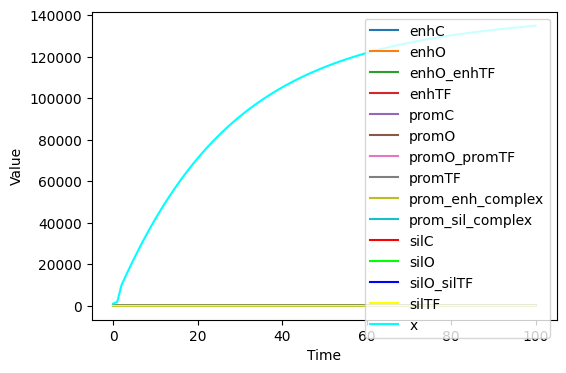

In [ ]:
ode_results.plot(figsize=(6, 4))

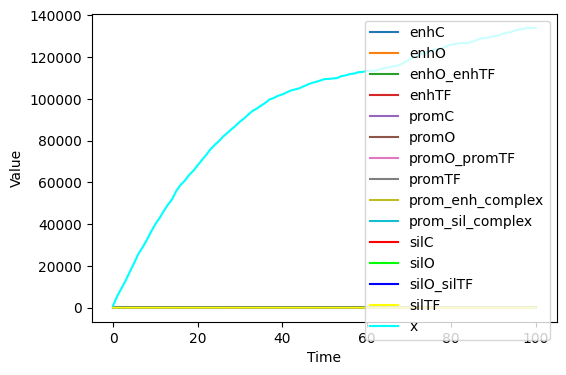

In [ ]:
ssa_results.plot(figsize=(6, 4))

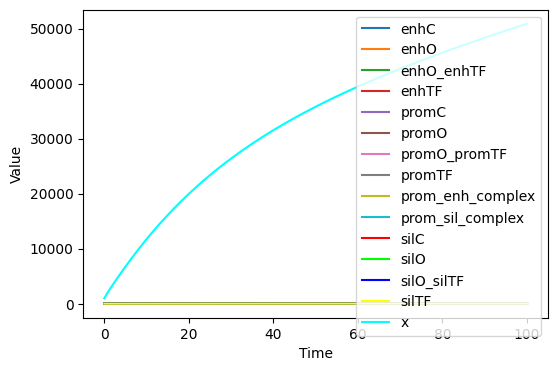

In [ ]:
ode_results_eq.plot(figsize=(6, 4))

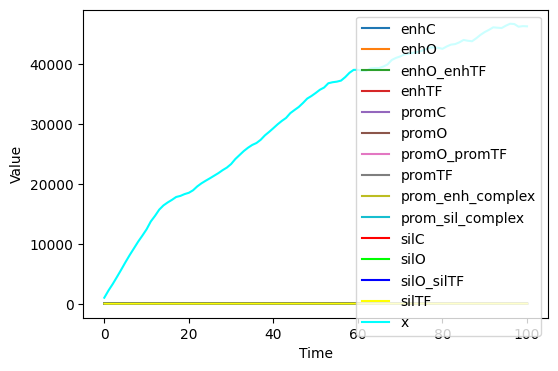

In [ ]:
ssa_results_eq.plot(figsize=(6, 4))

We can see that with current initial parameters both models show increase of x values and reach the steady state. We can noticec several details:
* Stochastic simulation result in sightly higher steady states than ODE simulatio, especially for the second model
* The second model has a less steep slope and is reaching the steady state later
* Overall values of the steady state are different for two models: first model shows more than two times higher results

### Multiple simulations, Ehn, Sil, Enh+Sil


We performed the single ran in the previous section, so here we will run several simulations to see the average trajectory and the noise generated.

Initializing solvers:

In [6]:
solverSSAC = gillespy2.SSACSolver(model, variable=True)
solverODE = gillespy2.ODECSolver(model, variable=True)

solverSSAC_eq = gillespy2.SSACSolver(model_eq, variable=True)
solverODE_eq = gillespy2.ODECSolver(model_eq, variable=True)

First, we will look at the model's behaviour in three cases:
1. none of ehnancer and silencer is present
2. only silencer is present in the model
3. only enhancer is present in the model

Parameters definition for each case:

We will set all parameters related to the not-present components equal to 0, and leave the rest as initialized.

In [ ]:
wo_enh_sil = {'enhO': 0, 'enhO_enhTF': 0, 'enhC': 0, 'enhTF': 0,
              'prom_enh_complex': 0, 'prom_sil_complex': 0,
              'silO': 0, 'silC':0, 'silO_silTF':0, 'silTF':0,
              'bindETF': 0, 'bindSTF': 0, 'kEon': 0, 'kEoff': 0,
              'kSon': 0,  'kSoff': 0, 'prom_enh_bind': 0, 'prom_sil_bind': 0,
              'prom_enh_unbind': 0, 'prom_sil_unbind': 0, 'unbindETF':0, 'unbindSTF':0
            }

wo_enh = {'enhO': 0, 'enhO_enhTF': 0, 'enhC': 0, 'enhTF': 0, 'prom_enh_complex': 0,
          'bindETF': 0, 'unbindETF':0, 'kEon': 0, 'kEoff': 0,
          'prom_enh_bind': 0, 'prom_enh_unbind': 0
          }

wo_sil = {'prom_sil_complex': 0, 'silO': 0, 'silC':0, 'silO_silTF':0, 'silTF':0,
          'bindSTF': 0, 'unbindSTF':0, 'kSon': 0, 'kSoff': 0,
          'prom_sil_bind': 0, 'prom_sil_unbind': 0
          }

Once we have defined the parameters, we will perform simulations for each of two models using these parameters:

2023-10-24 12:02:57,606 - GillesPy2 - WARNING - Results is of type list. Use results[i]['time'] instead of results['time']
2023-10-24 12:02:57,607 - GillesPy2 - WARNING - Results is of type list. Use results[i]['x'] instead of results['x']
2023-10-24 12:03:13,999 - GillesPy2 - WARNING - Results is of type list. Use results[i]['time'] instead of results['time']
2023-10-24 12:03:14,000 - GillesPy2 - WARNING - Results is of type list. Use results[i]['x'] instead of results['x']
2023-10-24 12:03:26,587 - GillesPy2 - WARNING - Results is of type list. Use results[i]['time'] instead of results['time']
2023-10-24 12:03:26,589 - GillesPy2 - WARNING - Results is of type list. Use results[i]['x'] instead of results['x']
2023-10-24 12:03:35,475 - GillesPy2 - WARNING - Results is of type list. Use results[i]['time'] instead of results['time']
2023-10-24 12:03:35,486 - GillesPy2 - WARNING - Results is of type list. Use results[i]['x'] instead of results['x']
2023-10-24 12:04:16,633 - GillesPy2 - WA

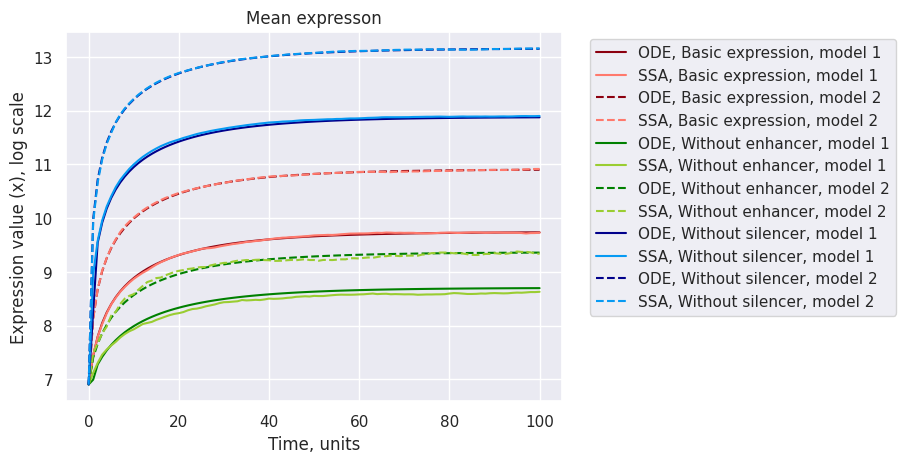

In [ ]:
def plot_ode_ssa(res_ode, res_ssa, title, color, mode):
    # function to plot lineplots for ode and ssa results
    ode_avg = res_ode.average_ensemble().data[0]
    ssa_avg = res_ssa.average_ensemble().data[0]
    plt.plot(ode_avg['time'], np.log(ode_avg['x']), mode, label=f"ODE, {title}",
             color = color[0])
    plt.plot(res_ssa['time'], np.log(res_ssa['x']), mode, label=f"SSA, {title}",
             color = color[1])


plt.figure()
for params, name, colors in zip([wo_enh_sil, wo_enh, wo_sil],
    ["Basic expression", "Without enhancer", "Without silencer"],
    [("#8C000F", "#FF796C"), ("#008000", "#9ACD32"), ("#00008B", "#069AF3")]):

    # first model
    ssa_results = model.run(solver=solverSSAC, number_of_trajectories=50,
                            variables=params)
    ode_results = model.run(solver=solverODE, number_of_trajectories=50,
                            variables=params)
    plot_ode_ssa(ode_results, ssa_results, f"{name}, model 1", colors,
                 mode="-")

    # second model
    eq_ssa_results = model_eq.run(solver=solverSSAC_eq, number_of_trajectories=50,
                            variables=params)
    eq_ode_results = model_eq.run(solver=solverODE_eq, number_of_trajectories=50,
                            variables=params)
    plot_ode_ssa(eq_ode_results, eq_ssa_results, f"{name}, model 2", colors,
                 mode="--")

plt.title("Mean expresson", fontsize=12)
plt.legend()
plt.xlabel("Time, units")
plt.ylabel("Expression value (x), log scale")
plt.legend(bbox_to_anchor=(1.04, 1))
plt.show()



We observe that as expected, the only silencer model gives slower values than the base model and the only enhancer model, on the contarary, gives the higher expression. We can also see that even though SSA simulation has some fluctuations, the trajectory exactly matches the ODE trajectory.

### Parameters exploration, means & std plotting

In order to analyse parameter space for our models, we will run simulations with different reaction rates and initial concentrations values from the certain range. First, we will explore values equal to $0.001, 0.01, 1, 10$. In order to do this, we will simply iterate over parameters, set selected parameter to each value from our list and perform a simulation.

Note, that the final value response to the reaction rate change will strongly depend on values of other parameters. So later  we will explore how change in some parameters simultaneously will change the expression.

In [ ]:
def run_multi_param_values(models, solvers, values=[0.001, 0.01, 1, 10],
                           num_sims=100):
    """
    Params:
        models: <dict> of initiated models (name: model)
        solvers: <dict> of tuples, pairs of ODE and SSA solvers, for each model
        values: <list> parameter values to check
        num_sims: <int> number of simulations (trajectories) to perform
    Returns:
        complex <dict>, with results for each parameter for each explored value
        for all models from "models"
    """

    # "solvers" should have two solvers for each model
    assert set([len(solvers[mname]) for mname in solvers.keys()]) == {2}

    results = dict()
    # iterating over models
    for name, init_model in models.items():
        print(f"==== simulations for the model {name} ====")
        results[name] = {"ODE": dict(), "SSA": dict()}
        ode_solver, ssa_solver = solvers[name]
        # iterating over parameters (species and reaction rates)
        for par in list(init_model.get_all_parameters().keys())+list(init_model.get_all_species().keys()):
            results[name]["ODE"][par], results[name]["SSA"][par] = dict(), dict()
            for var in values:
                results[name]["ODE"][par][var] = init_model.run(
                    solver=ode_solver, number_of_trajectories=num_sims,
                    variables={par: var}
                    )
                results[name]["SSA"][par][var] = init_model.run(
                    solver=ssa_solver, number_of_trajectories=num_sims,
                    variables={par: var}
                    )
            print(par, 'done')

    return results


This will take several hours depending on the resourses available and the internet connection

In [ ]:
models = {"model 1": model, "model 2": model_eq}
solvers = {"model 1": [solverODE, solverSSAC],
           "model 2": [solverODE_eq, solverSSAC_eq]}
results = run_multi_param_values(models, solvers)

==== simulations for the model model 1 ====
bindETF done
bindPTF done
bindSTF done
delta done
kEoff done
kEon done
kPoff done
kPon done
kSoff done
kSon done
ktr_act done
ktr_const done
prom_enh_bind done
prom_enh_unbind done
prom_sil_bind done
prom_sil_unbind done
unbindETF done
unbindPTF done
unbindSTF done
enhC done
enhO done
enhO_enhTF done
enhTF done
promC done
promO done
promO_promTF done
promTF done
prom_enh_complex done
prom_sil_complex done
silC done
silO done
silO_silTF done
silTF done
x done
==== simulations for the model model 2 ====
bindETF done
bindPTF done
bindSTF done
delta done
kEoff done
kEon done
kPoff done
kPon done
kSoff done
kSon done
ktr_act done
ktr_const done
prom_enh_bind done
prom_enh_unbind done
prom_sil_bind done
prom_sil_unbind done
unbindETF done
unbindPTF done
unbindSTF done
enhC done
enhO done
enhO_enhTF done
enhTF done
promC done
promO done
promO_promTF done
promTF done
prom_enh_complex done
prom_sil_complex done
silC done
silO done
silO_silTF done
silT

In [ ]:
np.save('simulations_100_params.npy', results)
files.download('simulations_100_params.npy')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# run to load saved datasets
results=np.load("simulations_100_params.npy", allow_pickle=True, fix_imports=True)

'var_results_ss=np.load("reag_conc_ssa_d005.npy", allow_pickle=True, fix_imports=True)\nvar_results_ode=np.load("reag_conc_ode_d005.npy", allow_pickle=True, fix_imports=True)'

Now we can plot means and standart deviations for each run. This visualisation can help us to identify parameter values that can narrow down or widen the noise of the steady state.

/root/.local/lib/python3.10/site-packages/gillespy2/core/results.py:820: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=figsize)


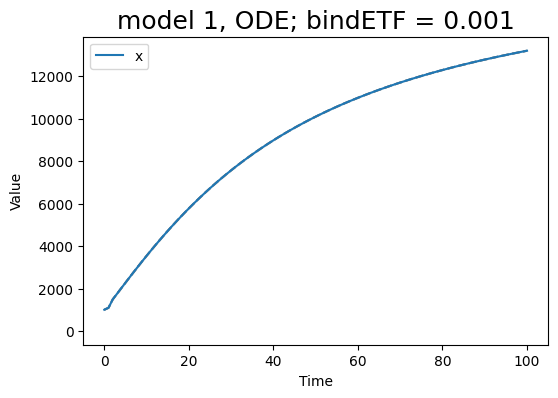

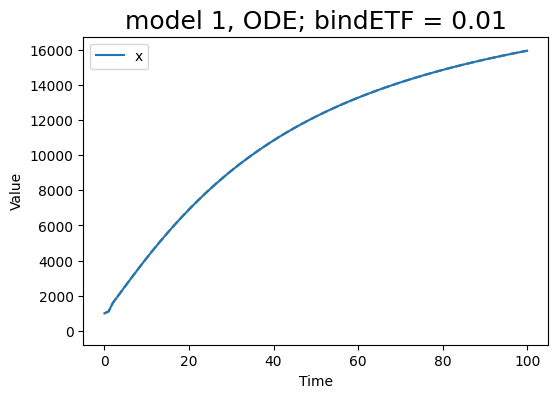

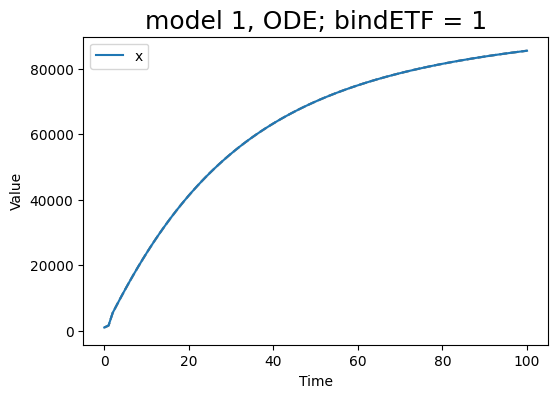

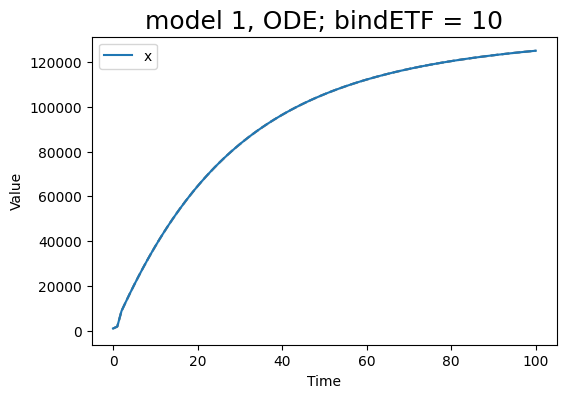

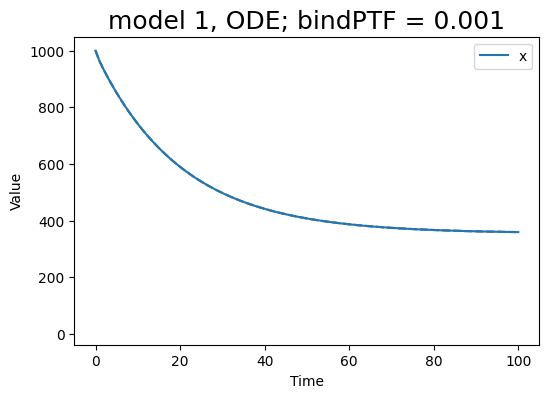

...

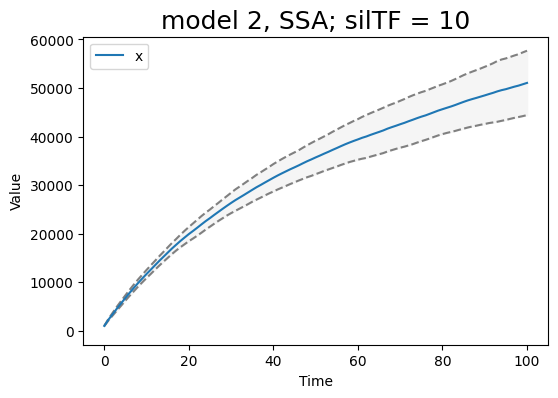

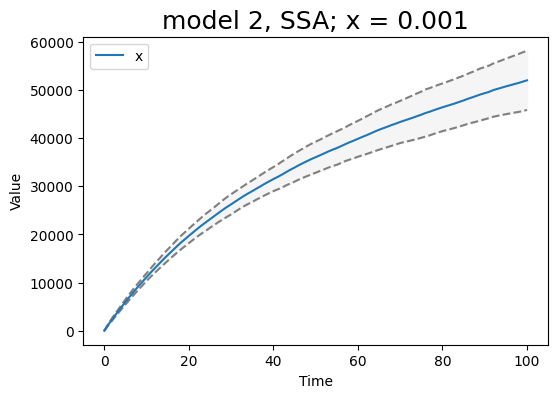

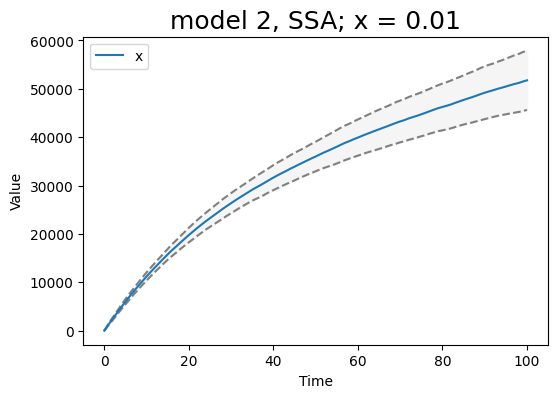

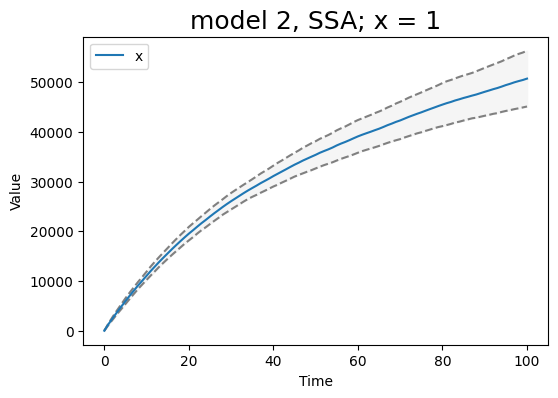

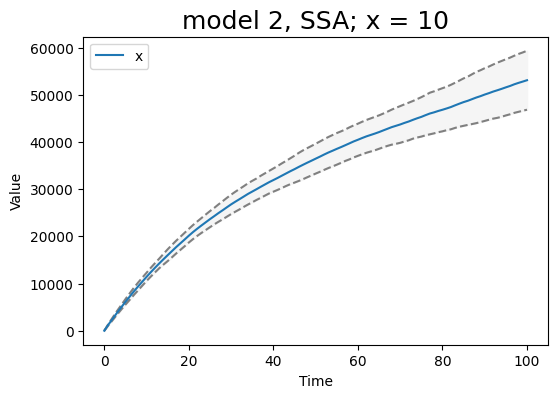

In [ ]:
for m in models.keys():
    for s in ["ODE", "SSA"]:
        for par in results[m][s].keys():
            for var in results[m][s][par].keys():
                res = results[m][s][par][var]
                res.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'],
                                    show_title=True, title=f'{m}, {s}; {par} = {var}')

### Parameters exploration, only means plotting

Using the data generated in the previous section we can now plot just means and compare trajectories between different values for each parameter.

<ipython-input-12-b54c5fbeff07>:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


<Figure size 600x400 with 0 Axes>

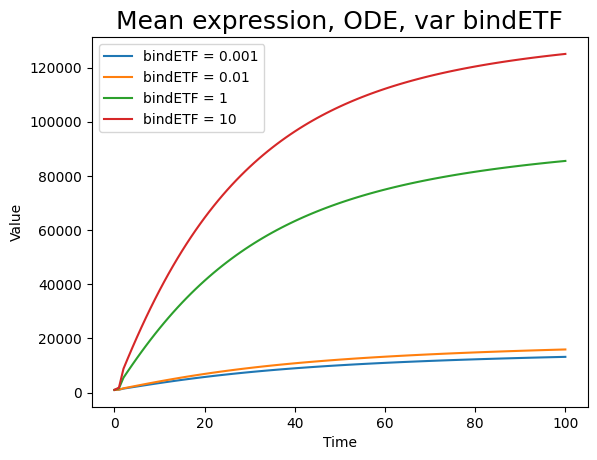

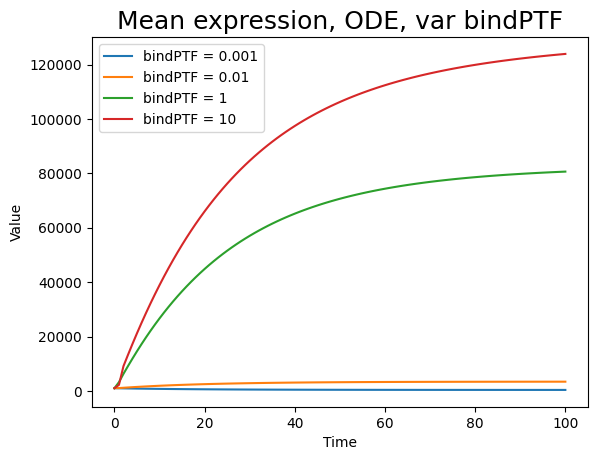

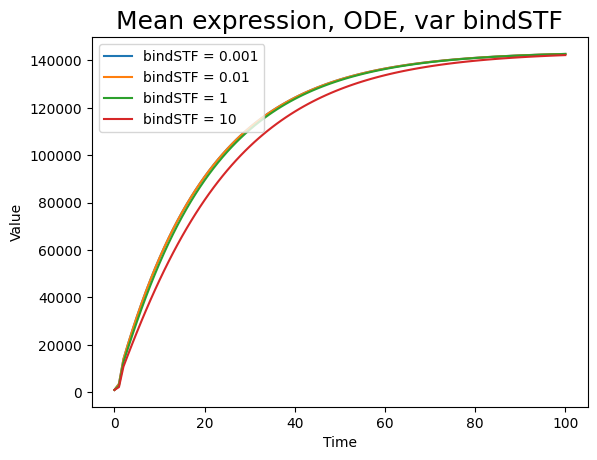

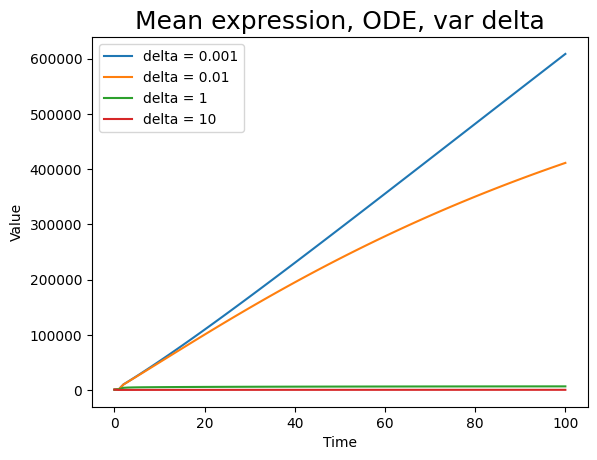

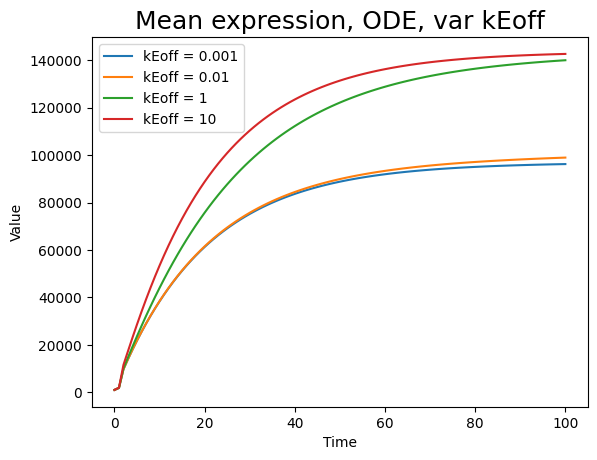

...

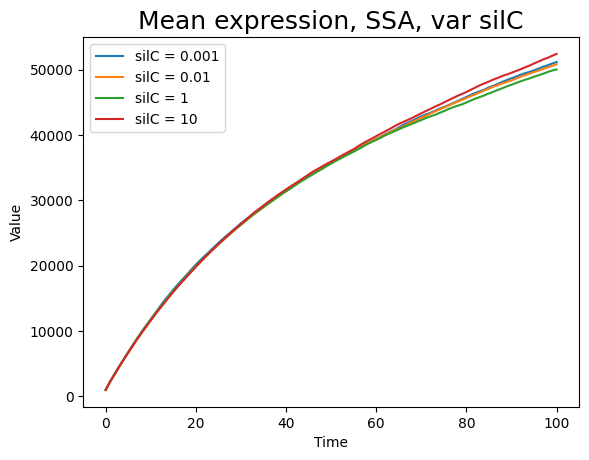

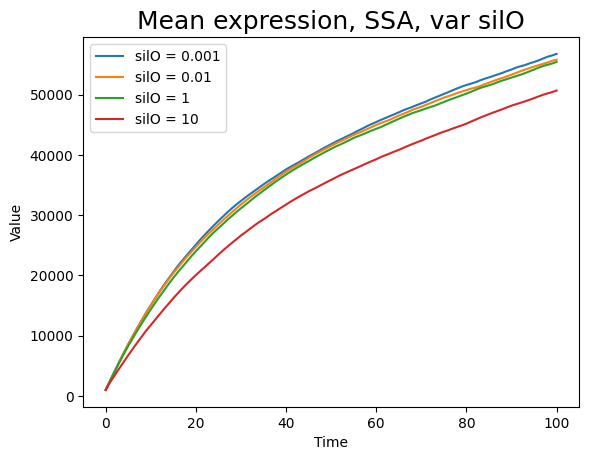

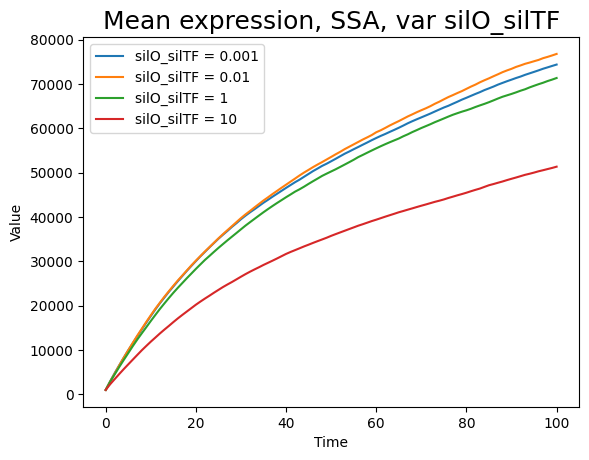

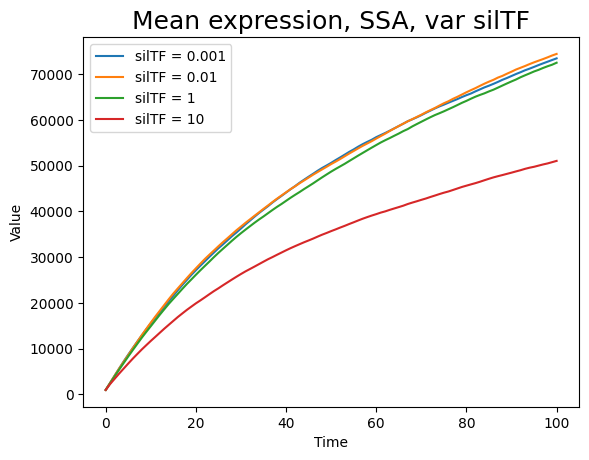

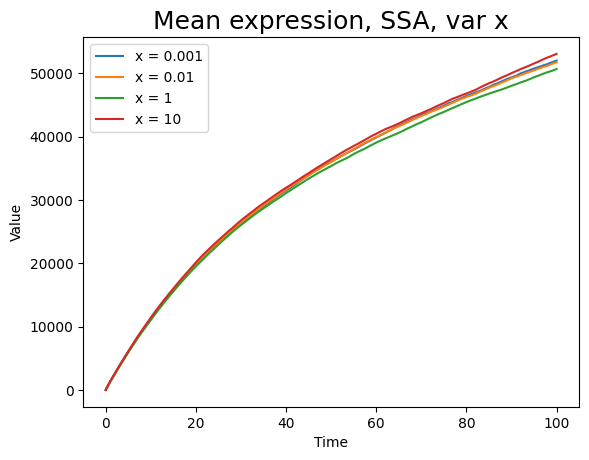

In [ ]:
#plt.style.use("default")
plt.figure(figsize=(6, 4))

def plot_avg(data, s, p, v):
    average_result = data.average_ensemble().data[0]
    plt.plot(average_result['time'], average_result['x'], label=f'{p} = {v}')
    plt.title(f'Mean expression, {s}, var {p}', fontsize=18)
    plt.xlabel("Time")
    plt.ylabel("Value")
    plt.legend(loc='upper left')


for m in models.keys():
    for s in ["ODE", "SSA"]:
        for par in results[m][s].keys():
            plt.figure()
            for var in results[m][s][par].keys():
                res = results[m][s][par][var]
                plot_avg(res, s, par, var)


### Plotting the x distributions

Since ultimately we are interested in silulating a real data, for example raw counts or TPM, it is important to explore the distribution of steady states (or final values of the simulation). Here we will, first, look at the distribution we got from the simulation in the previous.

Then, to get closer to the real world data we will plug in not just one value for all trajectories, but will sample a certain distribution of the parameter (as we have multiple genes in real samples) and run simulations for different "genes".

In [25]:
# run to load saved datasets
results=np.load("/content/drive/MyDrive/simulations_100_params.npy", allow_pickle=True, fix_imports=True)
res = results.item()

In [26]:
"""
# we can run this to verify that we loaded a correct array
def print_keys(dictionary):
    if isinstance(dictionary, dict):
        for key in dictionary.keys():
            print(key)
            print_keys(dictionary[key])
print_keys(results)
"""

'\n# we can run this to verify that we loaded a correct array \ndef print_keys(dictionary):\n    if isinstance(dictionary, dict):\n        for key in dictionary.keys():\n            print(key)\n            print_keys(dictionary[key])\nprint_keys(results)\n'

In [27]:
def get_the_last(res):
    # takes the res and returns x for all repetitions
    x = []
    for i in res:
        x.append(i['x'][-1])
    return x

#### For different parameter values
Using data from the previous section:

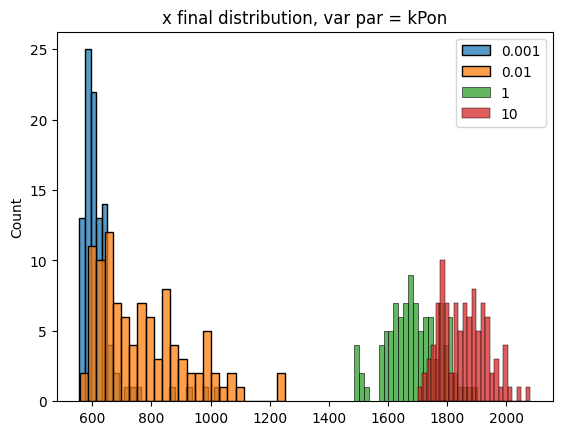

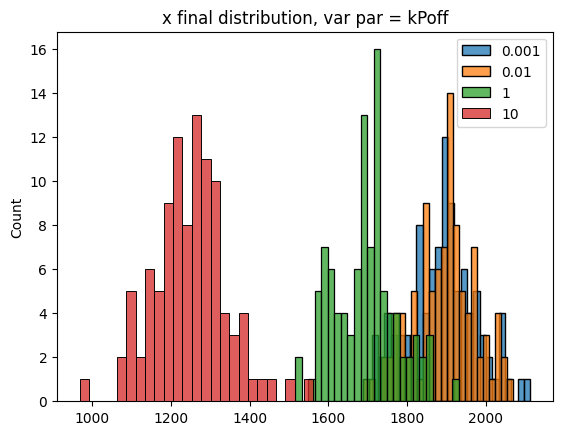

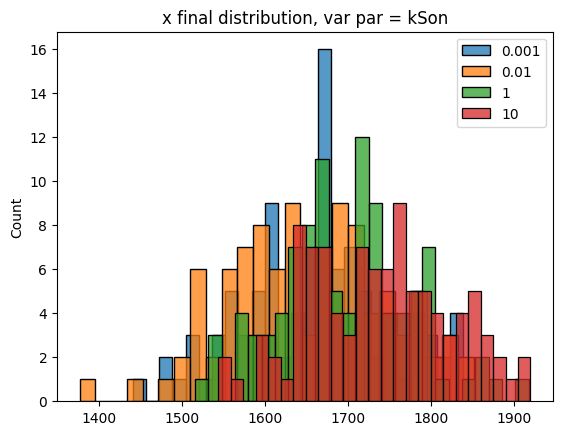

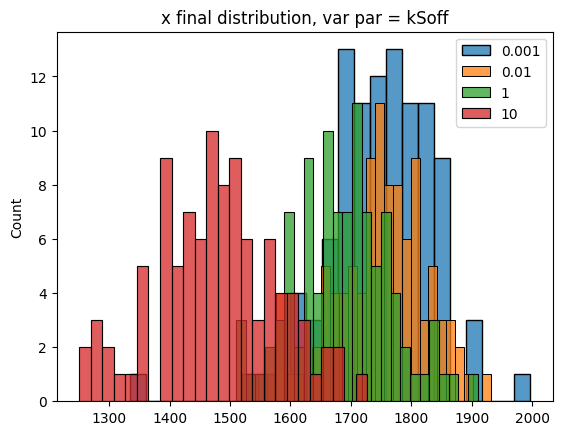

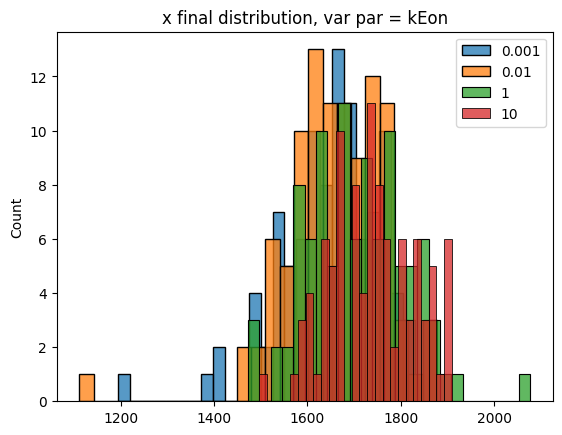

...

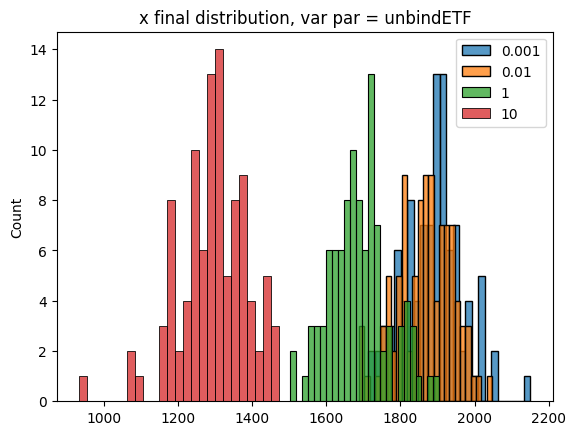

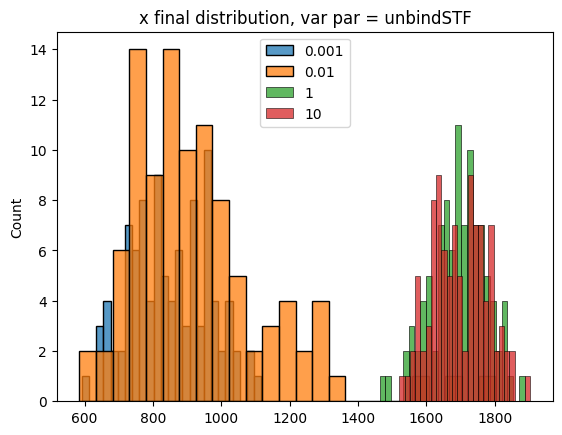

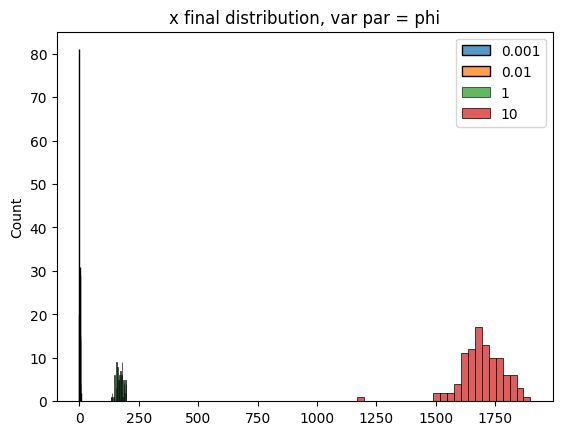

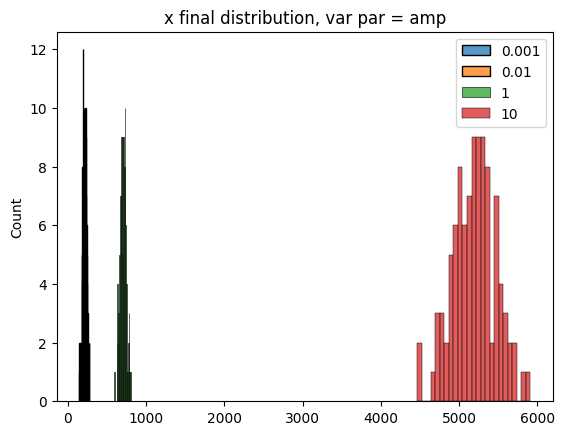

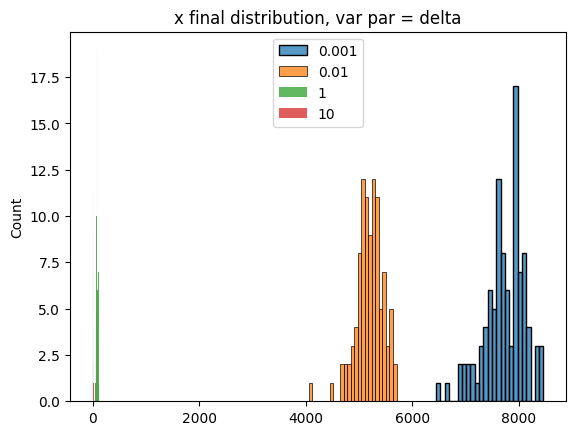

In [ ]:
for m in models.keys():
    for s in ["ODE", "SSA"]:
        for par in results[m][s].keys():
            plt.figure()
            for var in results[m][s][par].keys():
                res = results[m][s][par][var]
                res_last = get_the_last(res)
                sns.histplot(res_last, bins=25, label=f"{par} = {var}").set_title(f'{m}, {s}; {par} = {var}')
            plt.legend()

for par in res.keys():
    plt.figure()
    for var in res[par].keys():
        res_par = res[par][var]
        x = get_the_last(res_par)
        sns.histplot(x, bins=25, label=var).set_title(f'x final distribution, var par = {par}')
    plt.legend()

With data generation:

<ipython-input-48-30772e46c42e>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


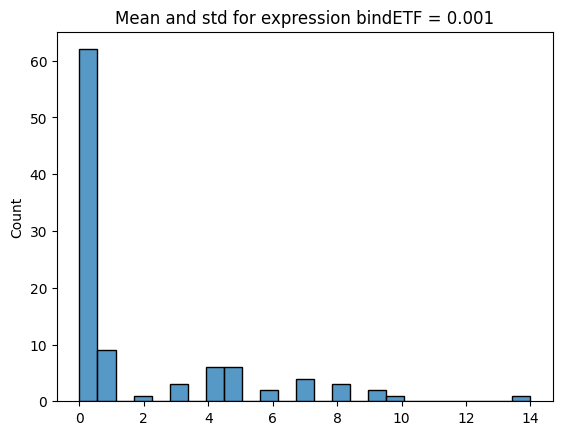

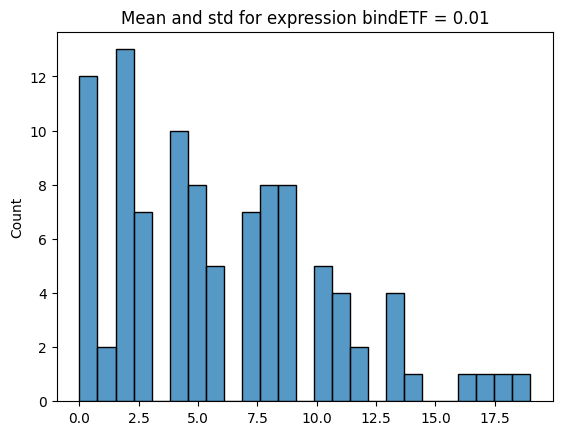

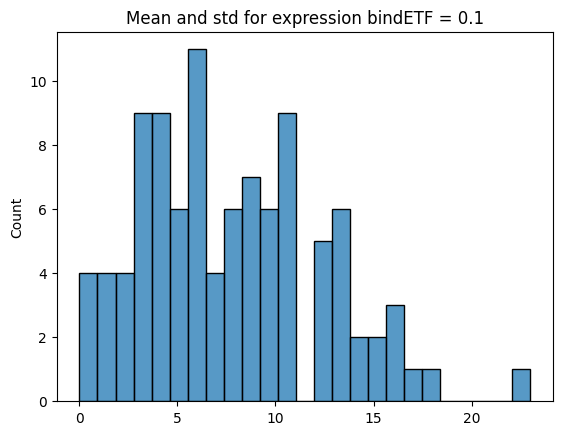

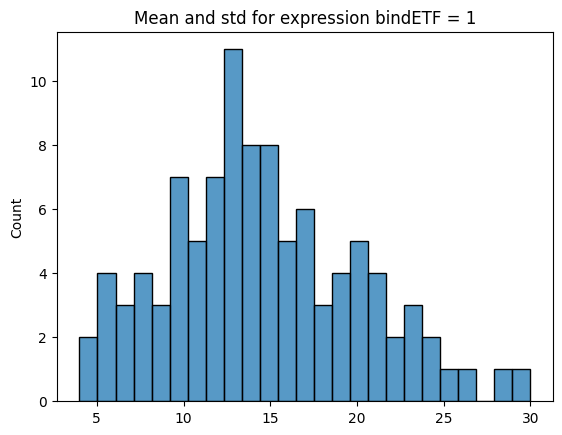

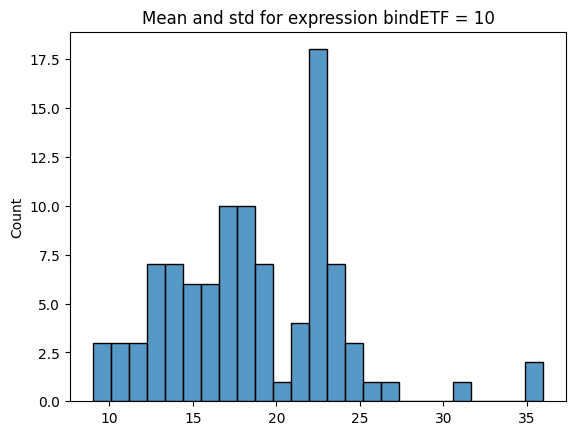

...

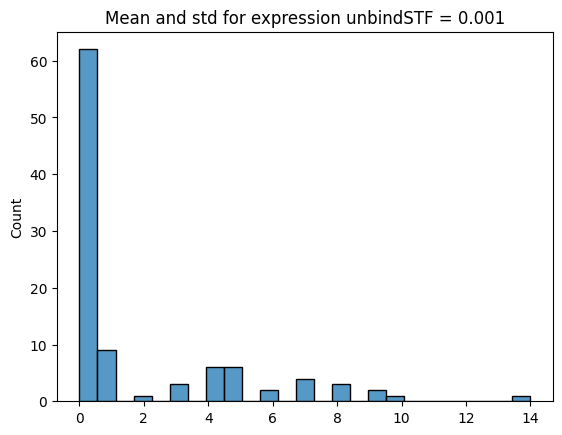

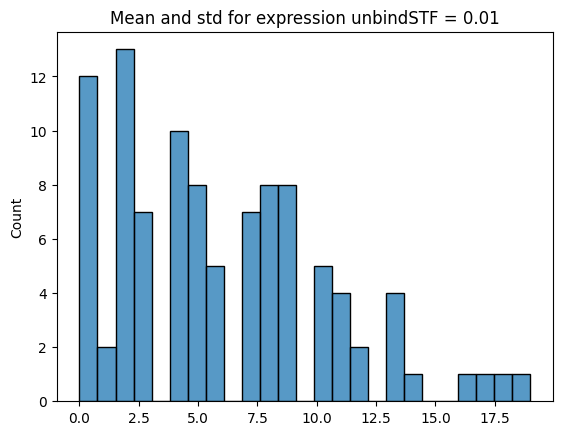

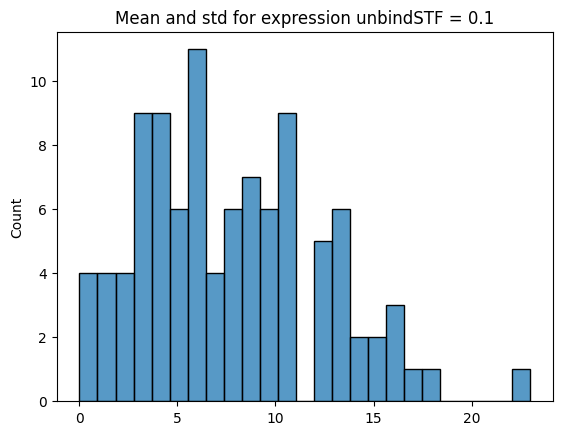

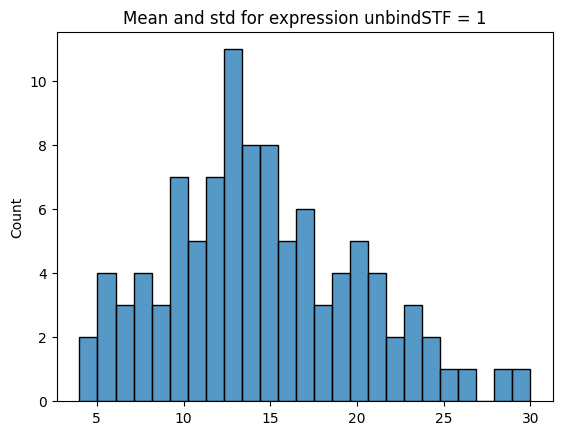

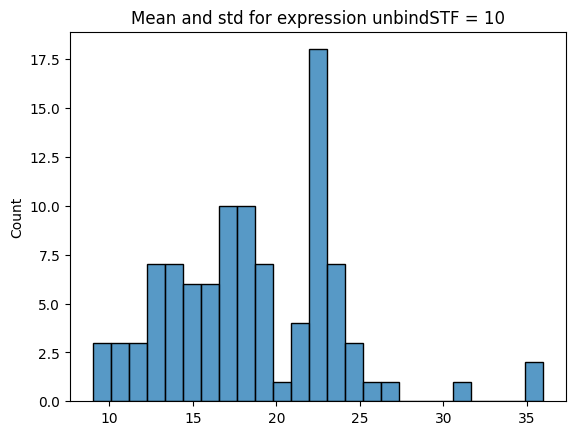

In [ ]:
model = create_transcr_model1()
solverSSAC = gillespy2.SSACSolver(model, variable=True)

var_results_ss = []

def iterate_multiple_values(model):
    for par in list(model.get_all_parameters().keys()):
        for var in [0.01, 0.05, 0.1, 1, 100]:
            var_results_ss.append(
                model.run(solver=solverSSAC, number_of_trajectories=100,
                        variables={par: var})
            )

iterate_multiple_values(model)

for par in list(model.get_all_parameters().keys()):
    for var, ss_res in zip([0.001, 0.01, 0.1, 1, 10], var_results_ss):
        #ss_res.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'],
         #                   show_title=True,
          #                     title=f'Mean and std for expression {par} = {var}')
        plt.figure()
        x = get_the_last(ss_res)
        sns.histplot(x, bins=25).set_title(f'Mean and std for expression {par} = {var}')

#### For higher values in log scale (simulating TPM with log10 scale) for 2 samples

We can sample initial x vals from different distributions:
* simply uniformal
* poisson, but since we want to have high range of values (from 0 to 1e5), it might be hard to sample directly --> we will use the Poisson approximation to binomial, then:

Probability of success in each binomial trial: p = mean / max_value <br>
Number of binomial trials: n = max_value

In [ ]:
'''
1. Uniformal
x_base_unif = np.random.uniform(min, max, size=sample_size)

2. Negative Binomial
neg_binom_samples = np.random.negative_binomial(n, p, sample_size)
neg_binom_samples = np.clip(neg_binom_samples, min, max)
# params: p in [0.1, 0.2, 0.4, 0.5] ; n in [0.5, 1, 2]

3. Zipf
zipf_samples = zipf.rvs(1+a, size=sample_size)
# params: a in [0.1, 0.2, 0.25, 0.3]

4. Lognormal
lognormal = np.random.lognormal(mu, sigma, 1000)
# params: mu in [0, 3, 5] ; sigma in [0.1, 0.5, 1, 3]

5. Poisson
poiss = np.random.poisson(lam, sample_size)
poiss = np.clip(poiss, min, max)
# params: lam = 1 is ok

6. Gamma
gamma = np.random.gamma(shape, scale, 1000)
gamma = np.clip(gamma, min, max)
# p[arams: scale in [1, 2] ; shape = 2 is ok

7. Weibull
weibull_samples = weibull_min.rvs(shape, scale=scale, size=sample_size)
weibull_samples = np.clip(weibull_samples, min, max)
# same as gamma, scale in [1, 2, 3] ; shape = 2 is ok

8. Beta
beta_samples = beta.rvs(a, b, size=sample_size)
# a = 2, b in [5, 10, 1000]

9. Exponential
exponential_samples = expon.rvs(scale=scale, size=sample_size)

10. Geometric
geometric_samples = np.random.geometric(p, size=sample_size)


--> try poisson with lam =1, zipf

'''

'\n1. Uniformal\nx_base_unif = np.random.uniform(min, max, size=sample_size)\n\n2. Negative Binomial\nneg_binom_samples = np.random.negative_binomial(n, p, sample_size)\nneg_binom_samples = np.clip(neg_binom_samples, min, max)\n# params: p in [0.1, 0.2, 0.4, 0.5] ; n in [0.5, 1, 2]\n\n3. Zipf\nzipf_samples = zipf.rvs(1+a, size=sample_size)\n# params: a in [0.1, 0.2, 0.25, 0.3]\n\n4. Lognormal\nlognormal = np.random.lognormal(mu, sigma, 1000)\n# params: mu in [0, 3, 5] ; sigma in [0.1, 0.5, 1, 3]\n\n5. Poisson\npoiss = np.random.poisson(lam, sample_size)\npoiss = np.clip(poiss, min, max)\n# params: lam = 1 is ok\n\n6. Gamma\ngamma = np.random.gamma(shape, scale, 1000)\ngamma = np.clip(gamma, min, max)\n# p[arams: scale in [1, 2] ; shape = 2 is ok\n\n7. Weibull\nweibull_samples = weibull_min.rvs(shape, scale=scale, size=sample_size)\nweibull_samples = np.clip(weibull_samples, min, max)\n# same as gamma, scale in [1, 2, 3] ; shape = 2 is ok\n\n8. Beta\nbeta_samples = beta.rvs(a, b, size=s

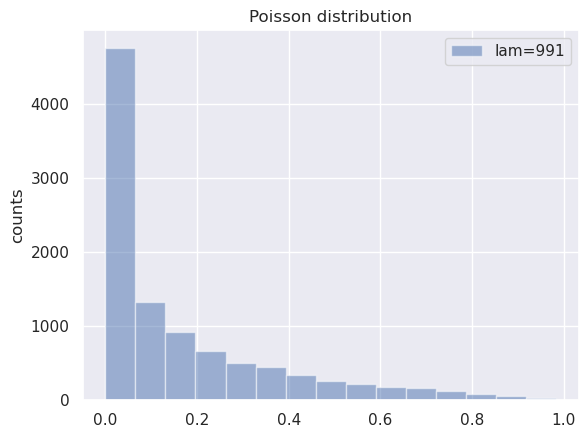

In [ ]:
# paste here values from above for the corresponding distribution
for a in [0.4]:
    beta_samples = beta.rvs(a, 2, size=sample_size)
    #plt.hist(np.log10(poiss), bins=15, label=f'lam={lam}', alpha=0.5)
    plt.hist(beta_samples, bins=15, label=f'lam={lam}', alpha=0.5)

#plt.xlabel('log10 x values')
plt.ylabel('counts')
plt.legend()
plt.title('Poisson distribution')
plt.show()

In [ ]:
mean = 100
min_val = 1
max_val = 100000
sample_size = 400

x_poiss = np.random.poisson(1, sample_size)
x_poiss = np.clip(x_poiss, min_val, max_val)

x_zipf = zipf.rvs(1+0.25, size=sample_size)
x_zipf = np.clip(x_zipf, min_val, max_val)

x_geom = np.random.geometric(0.2, size=sample_size)
x_geom = np.clip(x_geom, min_val, max_val)

x_weib = weibull_min.rvs(2, scale=1, size=sample_size)
x_weib = np.clip(x_weib, min_val, max_val)

x_unif = np.random.uniform(0, 1e6, size=sample_size)

And also we can sample the constants for kon/off. Let's try first with kPon, since it's directly related to the corresponding gene (enh/sil might regulate several genes). According to the plots above, the higher variability of final x coresponds to range from 0.001 to 1:

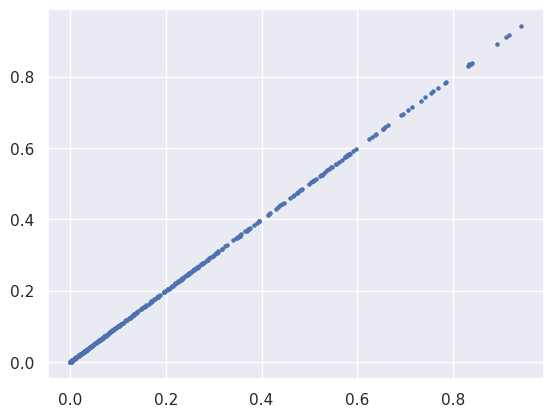

In [ ]:
#kPon = np.random.uniform(0, 1, size=sample_size)
kPon = beta.rvs(0.5, 2, size=sample_size)
plt.scatter(kPon, kPon, s=5);

Overlapping few poisson distributions with different lambdas:

In [ ]:
sample_size = 50  # samples in each subdistribution

s1, s2 = [], []
lambdas = [1, 10, 25, 50, 100, 500, 1000]
for lam in lambdas:
    s1 = np.concatenate((s1, np.random.poisson(lam, sample_size)))
    s2 = np.concatenate((s2, np.random.poisson(lam, sample_size)))

samples = pd.DataFrame({'sample1': s1, 'sample2': s2,
                        'lambda': sorted(lambdas*50)})
samples.head()

,sample1,sample2,lambda
0,0.0,1.0,1
1,0.0,0.0,1
2,1.0,1.0,1
3,3.0,0.0,1
4,0.0,0.0,1


In [ ]:
samples['lambda'] = samples['lambda'].astype('category')

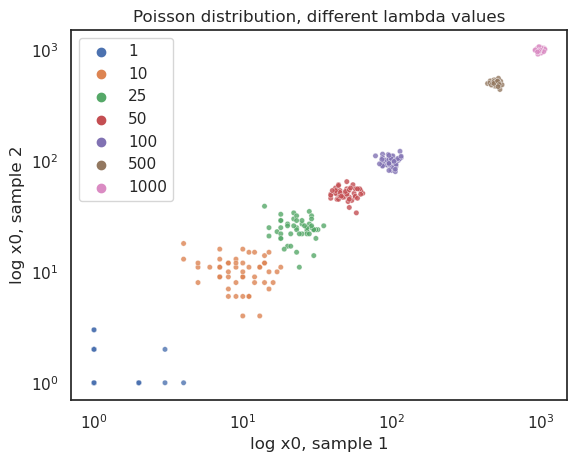

In [ ]:
sns.set_theme(style="white")

sns.scatterplot(data=samples, x='sample1', y='sample2', hue='lambda', s=15, alpha=0.8)
plt.yscale('log')
plt.xscale('log')
plt.xlabel('log x0, sample 1')
plt.ylabel('log x0, sample 2')
plt.legend()
plt.title('Poisson distribution, different lambda values')
plt.show()

<ipython-input-6-da1bfc9c5d41>:14: RuntimeWarning: divide by zero encountered in log10
  plt.scatter(np.log10(poiss[0]), np.log10(poiss[1]), s=5)


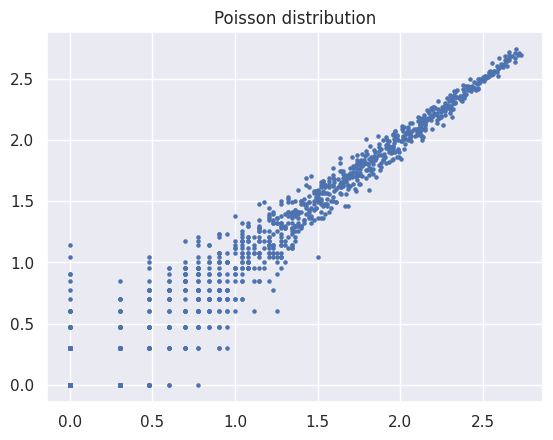

In [ ]:
sample_size = 50  # samples in each subdistribution

poiss = []
for _ in range(2):
    sample = np.random.poisson(1, sample_size)
    # lambdas from 1 to 1000 with step = 5
    for lam in np.arange(1, 1000, 5):
        sample = np.concatenate((sample, np.random.poisson(lam, (1050-lam)//lam)))
        #sample = np.concatenate((sample, np.random.poisson(lam, sample_size)))
        #plt.hist(np.log10(poiss), bins=15, label=f'lam={lam}', alpha=0.5)
        #plt.hist(np.log(pois), bins=15, label=f'lam={lam}', alpha=0.5)
    poiss += [sample]

plt.scatter(np.log10(poiss[0]), np.log10(poiss[1]), s=5)
#plt.xlabel('log10 x values')
#plt.ylabel('counts')
plt.title('Poisson distribution')
plt.show()

We want more small lambdas:  

/tmp/ipykernel_829311/983026082.py:15: RuntimeWarning: divide by zero encountered in log10
  plt.scatter(np.log10(poiss[0]), np.log10(poiss[1]), s=5)


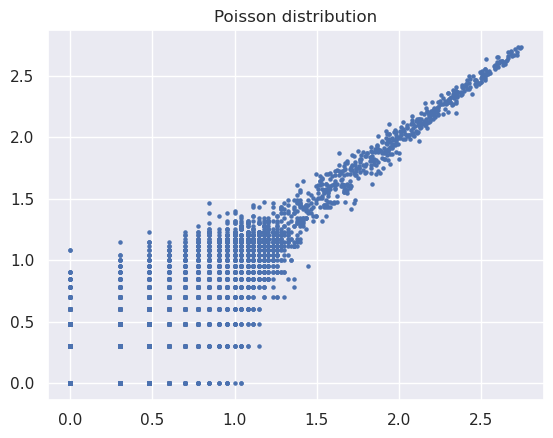

In [ ]:
# sample_size = 50  # samples in each subdistribution

poiss = []
for _ in range(2):
    sample = np.random.poisson(1, sample_size)

    for lam in np.arange(1, 15, 0.5):
        sample = np.concatenate((sample, np.random.poisson(lam, int((1050-lam)//lam))))
    # lambdas from 1 to 1000 with step = 5
    for lam in np.arange(1, 1000, 5):
        sample = np.concatenate((sample, np.random.poisson(lam, int((1050-lam)//lam))))
    poiss += [sample]


plt.scatter(np.log10(poiss[0]), np.log10(poiss[1]), s=5)
#plt.xlabel('log10 x values')
#plt.ylabel('counts')
plt.title('Poisson distribution')
plt.show()

(array([1421.,  137.,   83.,   57.,   34.,   30.,   31.,   22.,   23.,
          18.,   14.,   15.,    8.,    8.,   11.,    9.,    9.,    7.,
           2.,    5.,    7.,    7.,    2.,    2.,    4.,    3.,    3.,
           5.,    3.,    3.]),
 array([  0. ,  17.6,  35.2,  52.8,  70.4,  88. , 105.6, 123.2, 140.8,
        158.4, 176. , 193.6, 211.2, 228.8, 246.4, 264. , 281.6, 299.2,
        316.8, 334.4, 352. , 369.6, 387.2, 404.8, 422.4, 440. , 457.6,
        475.2, 492.8, 510.4, 528. ]),
 <BarContainer object of 30 artists>)

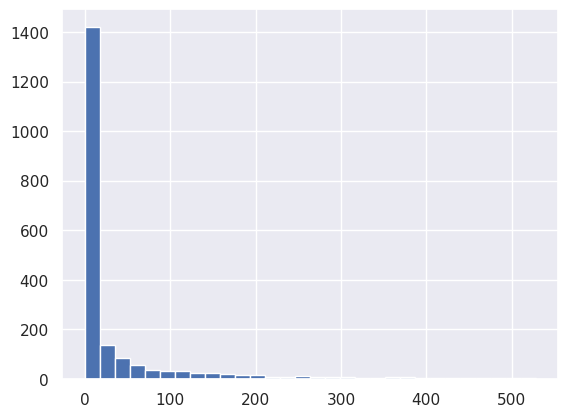

In [ ]:
plt.hist(poiss[0], bins=30)

In [ ]:
pois_01 = [None, None]
for i in range(2):
    p = poiss[i].reshape(-1, 1)
    scaler = MinMaxScaler()
    scaler.fit(p)
    x = scaler.transform(p)
    x = x.flatten()
    np.random.shuffle(x)
    pois_01[i] = x


/tmp/ipykernel_626448/2980628374.py:1: RuntimeWarning: divide by zero encountered in log10
  plt.scatter(np.log10(pois_01[1]), np.log10(pois_01[1]), s=5)


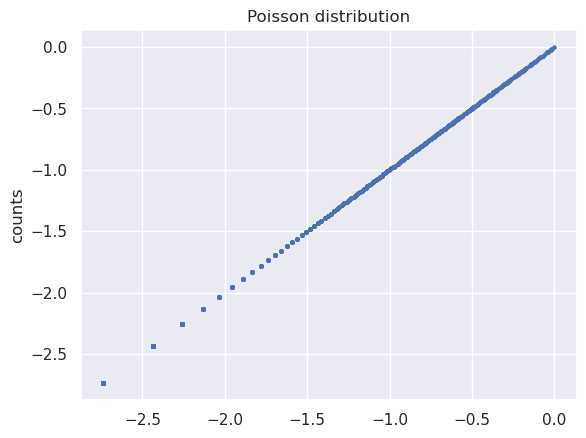

In [ ]:
plt.scatter(np.log10(pois_01[1]), np.log10(pois_01[1]), s=5)
#plt.xlabel('log10 x values')
plt.ylabel('counts')
plt.title('Poisson distribution')
plt.show()

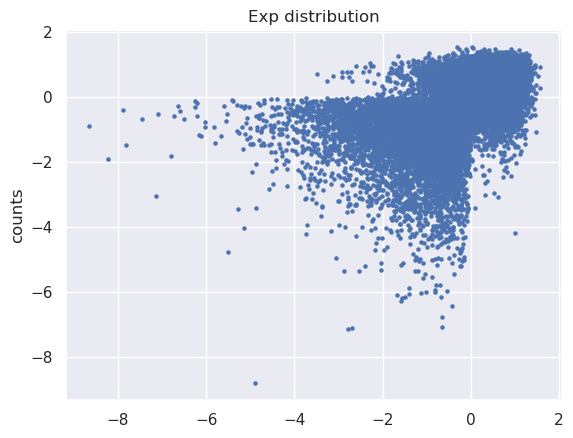

In [ ]:
sample_size = 10000  # Number of samples for each distribution

exp = []
for _ in range(2):
    sample = beta.rvs(0.5, 2, size=sample_size)
    # paste here values from above for the corresponding distribution
    for a in [0.25]:
        sample = np.concatenate((sample, np.random.exponential(1/a, size=sample_size)))
        #plt.hist(np.log10(poiss), bins=15, label=f'lam={lam}', alpha=0.5)
        #plt.hist(np.log(pois), bins=15, label=f'lam={lam}', alpha=0.5)
    exp += [sample]

plt.scatter(np.log10(exp[0]), np.log10(exp[1]), s=5)
#plt.xlabel('log10 x values')
plt.ylabel('counts')
plt.title('Exp distribution')
plt.show()

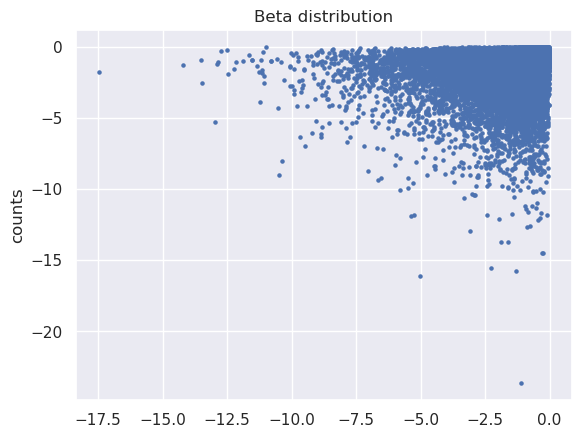

In [ ]:
sample_size = 10000  # Number of samples for each distribution

beta_s2 = []
for _ in range(2):
    sample = beta.rvs(0.5, 2, size=sample_size)
    # paste here values from above for the corresponding distribution
    for a in [0.25, 0.75, 1]:
        sample = np.concatenate((sample, beta.rvs(a, 2, size=sample_size)))
        #plt.hist(np.log10(poiss), bins=15, label=f'lam={lam}', alpha=0.5)
        #plt.hist(np.log(pois), bins=15, label=f'lam={lam}', alpha=0.5)
    beta_s2 += [sample]

plt.scatter(np.log10(beta_s2[0]), np.log10(beta_s2[1]), s=5)
#plt.scatter(beta_s2[0], beta_s2[1], s=5)
#plt.xlabel('log10 x values')
plt.ylabel('counts')
plt.title('Beta distribution')
plt.show()

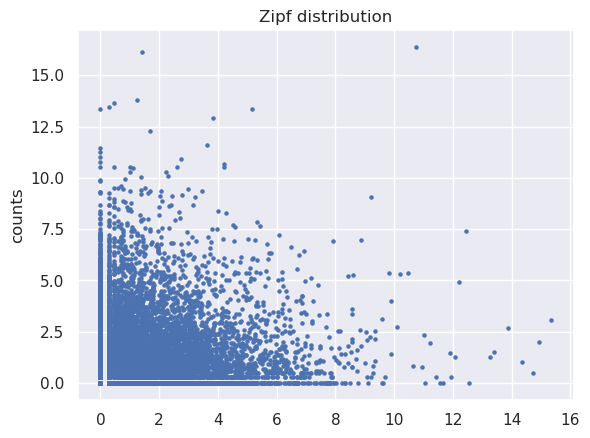

In [ ]:
# Lambda values for the Poisson distributions
lambdas = [1, 5, 10, 100]
sample_size = 10000  # Number of samples for each distribution

x_zipf_2s = []
for _ in range(2):
    sample = zipf.rvs(1+0.25, size=sample_size)
    # paste here values from above for the corresponding distribution
    sample = np.concatenate((sample, np.random.poisson(lam, sample_size)))
    x_zipf_2s += [sample]

plt.scatter(np.log10(x_zipf_2s[0]), np.log10(x_zipf_2s[1]), s=5)
#plt.xlabel('log10 x values')
plt.ylabel('counts')
plt.title('Zipf distribution')
plt.show()

In [ ]:
#model = create_transcr_model1()
#solverSSAC = gillespy2.SSACSolver(model, variable=True)
solverSSAC = gillespy2.SSACSolver(model2, variable=True)

In [ ]:
rate01_conc1 = {'delta': 0.005,'phi':10,'amp':1000,
                'enhO': 1, 'enhO_enhTF': 1, 'promO': 1, 'promO_promTF': 1,
                'prom_enh_complex': 1, 'prom_sil_complex': 1, 'silO': 1,
                'bindETF': 0.1, 'bindPTF': 0.1, 'bindSTF': 0.1, 'kEon': 0.1,
                'kPon': 0.1, 'kSon': 0.1, 'prom_enh_bind': 0.1, 'prom_sil_bind': 0.1
                }
rate1_conc01 = {'delta': 0.005,'phi':100,
                'enhO': 0.1, 'enhO_enhTF': 0.1, 'promO': 0.1, 'promO_promTF': 0.1,
                'prom_enh_complex': 0.1, 'prom_sil_complex': 0.1, 'silO': 0.1,
                'bindETF': 1, 'bindPTF': 1, 'bindSTF': 1, 'kEon': 1,
                'kPon': 1, 'kSon': 1, 'prom_enh_bind': 1, 'prom_sil_bind': 1
                }
rate01_conc01 = {'delta': 0.005, 'phi':100,
                'enhO': 0.1, 'enhO_enhTF': 0.1, 'promO': 0.1, 'promO_promTF': 0.1,
                'prom_enh_complex': 0.1, 'prom_sil_complex': 0.1, 'silO': 0.1,
                'bindETF': 0.1, 'bindPTF': 0.1, 'bindSTF': 0.1, 'kEon': 0.1,
                'kPon': 0.1, 'kSon': 0.1, 'prom_enh_bind': 0.1, 'prom_sil_bind': 0.1
                }

In [ ]:
def plot_df(results_df, n):
    pretty_df = pd.DataFrame({'sample 1' : np.log10(results_df.head(n)['results'].values),
                            'sample 2': np.log10(results_df.tail(n)['results'].values)})
    print('Pearson correlation:', pearsonr(pretty_df['sample 1'], pretty_df['sample 2']))
    g = sns.jointplot(x='sample 1',
                    y='sample 2',
                    data = pretty_df,
                    kind="reg", truncate=False,
                    #xlim=(0, 60), ylim=(0, 12),
                    color="m", height=7, scatter_kws={"s": 10})

    plt.xlabel("Sample 1, log10 scale")
    plt.ylabel("Sample 2, log10 scale")
    plt.show()

In [ ]:
poiss[0].shape

(1983,)

Pearson correlation: PearsonRResult(statistic=0.1247565895155321, pvalue=2.4923195542218768e-08)


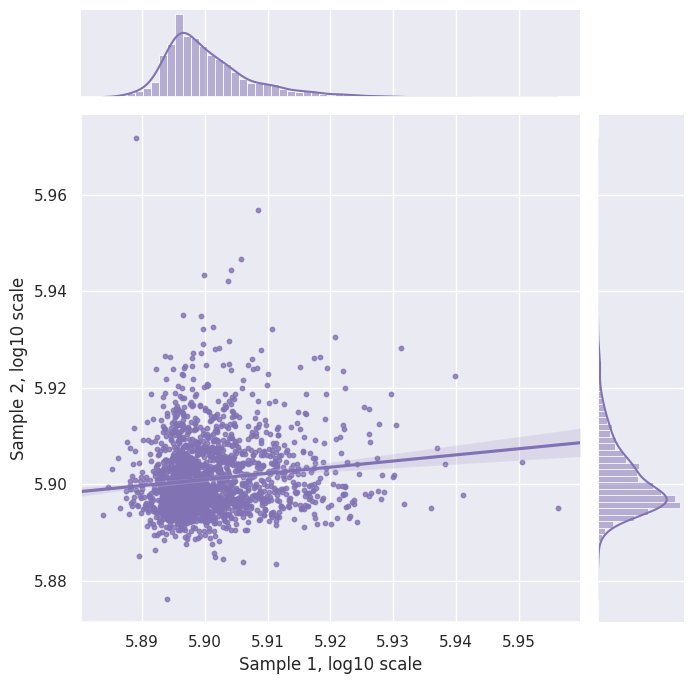

In [ ]:
var_results_ss = []
n=1983

#x_base = np.random.uniform(0, 1e6, size=n)
#kPon = np.random.uniform(0, 1, size=n)
kPon = beta.rvs(0.5, 2, size=n)
#x_zipf = zipf.rvs(1+0.1, size=n)
kPoff = np.random.uniform(0, 1, size=n)

for x_poiss in poiss:
    for x_val, kPon_val, kPoff_val in zip(x_poiss, kPon, kPoff):
    #for x_val in x_poiss:
        rate01_conc1['x'] = x_val
        rate01_conc1['kPon'] = kPon_val
        rate01_conc1['kPoff'] = kPoff_val
        res = model2.run(solver=solverSSAC, variables=rate01_conc1
                      )

        #res = model2.run(solver=solverSSAC, variables={'x': x_val, 'kPon': kPon_val})
        #res = model2.run(solver=solverSSAC, variables={'x': x_val, 'kPon': kPon_val, 'kPoff': kPoff_val})
        #res = model.run(solver=solverSSAC)
        #res = model.run(solver=solverSSAC, variables={'x': x_val})
        var_results_ss.append(res['x'][-1])

results_df = pd.DataFrame({'sample': [0]*n + [1]*n, 'results': var_results_ss})
plot_df(results_df, n)

In [ ]:
def add_noise(samples, mean=0, std = 0.2):
    return samples += np.random.normal(mean, std, size=(len(samples), ))

In [ ]:
pretty_df = pd.DataFrame({'sample 1' : np.log10(results_df.head(n)['results'].values),
                            'sample 2': np.log10(results_df.tail(n)['results'].values)})
pretty_df_notlog = pd.DataFrame({'sample 1' : results_df.head(n)['results'].values,
                            'sample 2': results_df.tail(n)['results'].values})
pretty_df.head()

,sample 1,sample 2
0,4.435032,4.447592
1,4.476295,4.456837
2,4.606929,4.608291
3,4.383259,4.403669
4,4.511509,4.514574


/tmp/ipykernel_829311/407213708.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  points['eucl_dist'] = (np.sign(points['sample 1'] - points['sample 2']))*((points['sample 1'] - mean)**2 + (points['sample 2'] - mean)**2)**(1/2)
/tmp/ipykernel_829311/407213708.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  points['eucl_dist'] = (np.sign(points['sample 1'] - points['sample 2']))*((points['sample 1'] - mean)**2 + (points['sample 2'] - mean)**2)**(1/2)
/tmp/ipykernel_829311/407213708.py:16: SettingWith

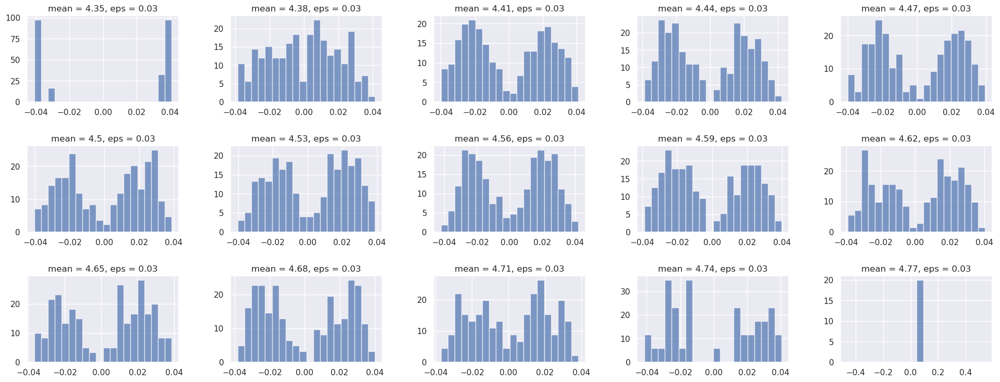

In [ ]:
# Create a new figure for the grid of subplots
fig, axes = plt.subplots(3, 5, figsize=(20, 8))
fig.tight_layout(pad=3.0)  # Adjust spacing between subplots

# Initialize a counter for the subplot position
plot_counter = 0

# Parameters
eps = 0.03

# Loop to generate plots for different means
for mean in np.arange(4.35, 4.78, 0.03):
    points = pretty_df[(pretty_df['sample 1'] >= mean-eps) & (pretty_df['sample 1'] <= mean+eps) & (
        pretty_df['sample 2'] >= mean-eps) & (pretty_df['sample 2'] <= mean+eps)]

    points['eucl_dist'] = (np.sign(points['sample 1'] - points['sample 2']))*((points['sample 1'] - mean)**2 + (points['sample 2'] - mean)**2)**(1/2)

    num_bins = 20
    hist, bins = np.histogram(points['eucl_dist'], bins=num_bins, density=True)

    # Plot in the current subplot
    ax = axes[plot_counter // 5, plot_counter % 5]
    ax.hist(bins[:-1], bins, weights=hist, alpha=0.7)
    ax.set_title(f'mean = {round(mean, 3)}, eps = {eps}')

    # Increment the counter for the next subplot
    plot_counter += 1

# Hide any empty subplots (if there are fewer than 8 plots)
for i in range(plot_counter, 8):
    axes[i // 4, i % 4].axis('off')

# Show the plots
plt.show()

/tmp/ipykernel_829311/3780858503.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  points['eucl_dist'] = (np.sign(points['sample 1'] - points['sample 2']))*((points['sample 1'] - mean)**2 + (points['sample 2'] - mean)**2)**(1/2)


AttributeError: 'tuple' object has no attribute 'title'

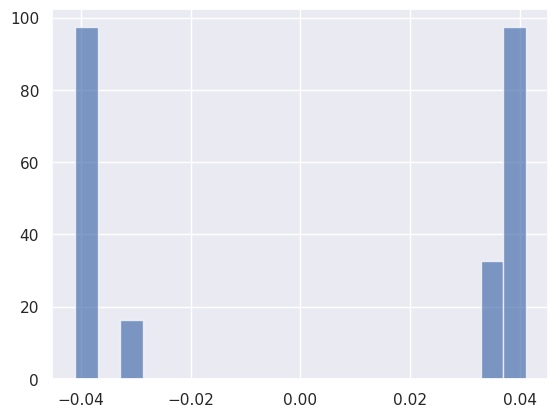

In [ ]:
cutoff_df = pd.DataFrame(columns=['mean', 'points'])
eps = 0.03

for mean in np.arange(4.35, 4.77, 0.03):
    points = pretty_df[(pretty_df['sample 1'] >= mean-eps) & (pretty_df['sample 1'] <= mean+eps) & (
        pretty_df['sample 2'] >= mean-eps) & (pretty_df['sample 2'] <= mean+eps)]
    #plt.scatter(points['sample 1'] - mean, points['sample 2'] - mean)
    points['eucl_dist'] = (np.sign(points['sample 1'] - points['sample 2']))*((points['sample 1'] - mean)**2 + (points['sample 2'] - mean)**2)**(1/2)

    num_bins = 20
    hist, bins = np.histogram(points['eucl_dist'], bins=num_bins, density=True)
    plt.hist(bins[:-1], bins, weights=hist, alpha=0.7)
    plt.title(f'mean = {round(mean, 3)}, eps = {eps}')


In [ ]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
plt.figure(figsize=(10, 6))

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(df[df['solver']=='stochastic'], row="x", hue="x", aspect=15, height=5, palette=pal)

# Draw the densities in a few steps
g.map(sns.kdeplot, "values",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "values", clip_on=False, color="w", lw=2, bw_adjust=.5)

# passing color=None to refline() uses the hue mapping
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)


# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, 0.2, label, size = 50, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)


g.map(label, "values")

# Set the subplots to overlap
g.figure.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
plt.xticks(fontsize=60)
plt.xlabel("X steady state", fontsize=50)
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)

### kEoff

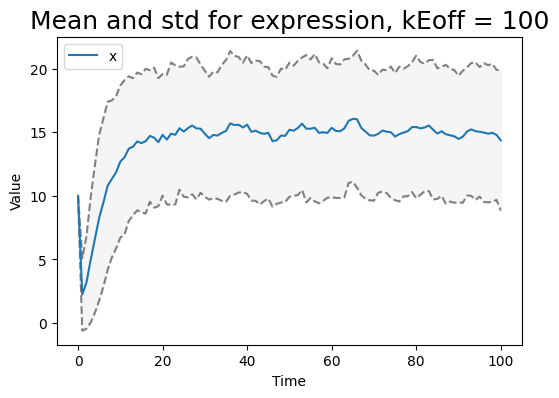

In [ ]:
ssa_results1.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'],
                           show_title=True, title=f'Mean and std for expression, kEoff = 100')

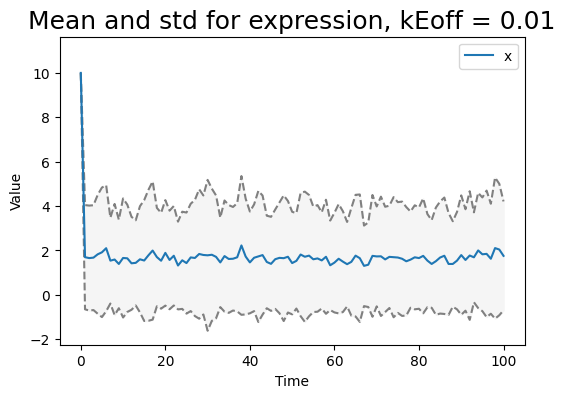

In [ ]:
ssa_results2.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'],
                           show_title=True, title=f'Mean and std for expression, kEoff = 0.01')

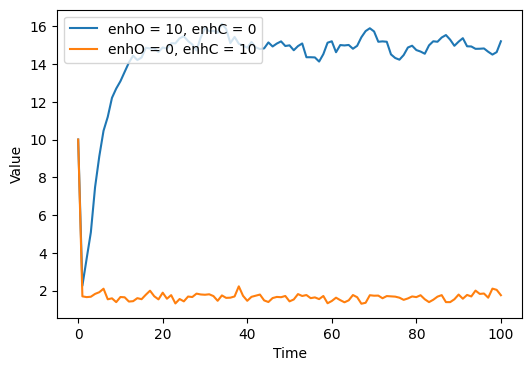

In [ ]:
plt.style.use("default")
plt.figure(figsize=(6, 4))

average_result = ssa_results1.average_ensemble().data[0]
plt.plot(average_result['time'], average_result['x'], label='enhO = 10, enhC = 0')
average_result = ssa_results2.average_ensemble().data[0]
plt.plot(average_result['time'], average_result['x'], label='enhO = 0, enhC = 10')
#plt.title(f'Mean expression, variable {par}', fontsize=18)
plt.xlabel("Time")
plt.ylabel("Value")
plt.legend(loc='upper left')

In [ ]:
x = []
gr = []
for i in ssa_results1:
    x.append(i['x'][-1])
    gr.append('kEoff = 100')
for i in ssa_results2:
    x.append(i['x'][-1])
    gr.append('kEoff = 0.01')

df = pd.DataFrame({'x': x, 'group': gr})

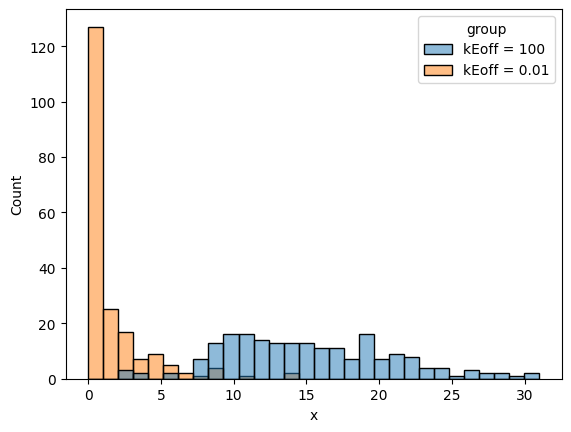

In [ ]:
sns.histplot(data=df, x='x', hue='group', bins=30);

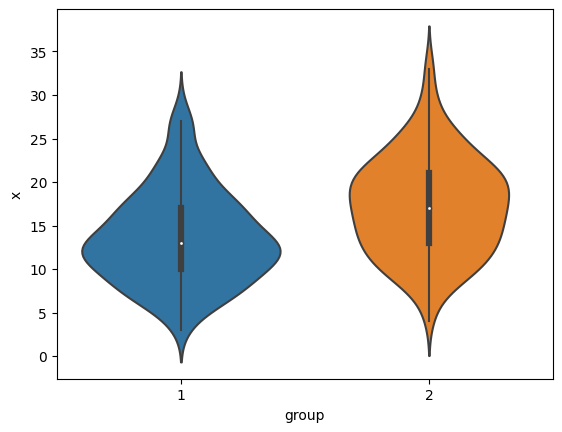

In [ ]:
sns.violinplot(data = df, y=df['x'], x=df['group'], split=True);

### How x0-x_final relationship will change depending on the  delta?


generating the data

In [ ]:
var_results_ss = {0: dict(), 0.001: dict(), 0.005: dict(), 0.01: dict(),
                  0.05: dict(), 0.1: dict(), 0.5: dict()}
var_results_ode = {0: dict(), 0.001: dict(), 0.005: dict(), 0.01: dict(),
                   0.05: dict(), 0.1: dict(), 0.5: dict()}

def iterate_multiple_values(model):
    for delta_val in var_results_ss.keys():
        for x_val in [0, 10, 100, 1000]:
            var_results_ss[delta_val][x_val] = model.run(
                solver=solverSSAC, number_of_trajectories=100, variables={
                    'delta': delta_val, 'x': x_val}
                )
            var_results_ode[delta_val][x_val] = model.run(
                solver=solverODE, number_of_trajectories=100, variables={
                    'delta': delta_val, 'x': x_val}
                )

iterate_multiple_values(model)

plotting

In [ ]:
df = {'x': list(), 'delta': list(), 'values': list(), 'solver': list()}
for res, solver_name in zip([var_results_ss, var_results_ode], ['stochastic', 'ode']):
    df['solver'] += [solver_name]*2800
    for delta_val in var_results_ss.keys(): # len = 2800
        df['delta'] += [delta_val]*400
        for x_val in [0, 10, 100, 1000]: # len = 400
            x_final = get_the_last(res[delta_val][x_val]) # len = 100
            df['x'] += [x_val]*100
            df['values'] += x_final

df = pd.DataFrame(df)

In [ ]:
df.head()

,x,delta,values,solver
0,0,0.0,585.0,stochastic
1,0,0.0,613.0,stochastic
2,0,0.0,543.0,stochastic
3,0,0.0,579.0,stochastic
4,0,0.0,671.0,stochastic


<Axes: xlabel='delta', ylabel='values'>

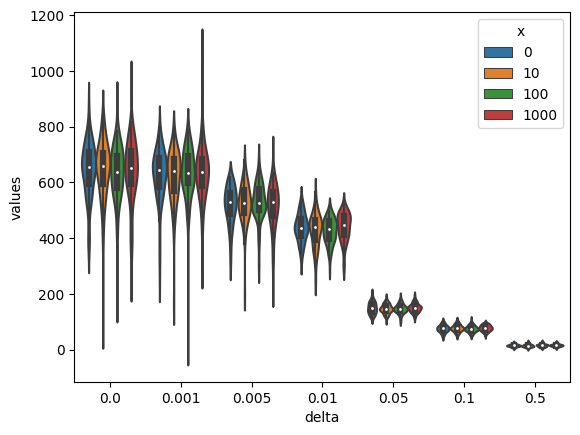

In [ ]:
sns.violinplot(data=df[df['solver']=='stochastic'], x='delta', y='values', hue='x')

<Axes: xlabel='delta', ylabel='values'>

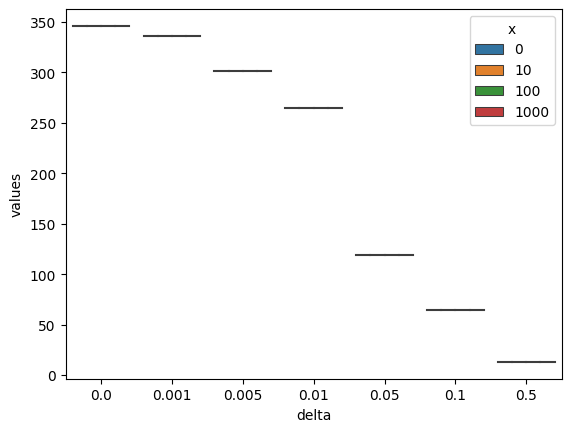

In [ ]:
sns.violinplot(data=df[df['solver']=='ode'], x='delta', y='values', hue='x')

### How x0-x_final relationship will change depending on formation constants?

In [ ]:
solverSSAC = gillespy2.SSACSolver(model, variable=True)
solverODE = gillespy2.ODECSolver(model, variable=True)

In [ ]:
model.get_all_parameters().keys()

odict_keys(['bindETF', 'bindPTF', 'bindSTF', 'delta', 'kEoff', 'kEon', 'kPoff', 'kPon', 'kSoff', 'kSon', 'phi', 'prom_enh_bind', 'prom_enh_unbind', 'prom_sil_bind', 'prom_sil_unbind', 'unbindETF', 'unbindPTF', 'unbindSTF'])

In [ ]:
var_results_ss = {0: dict(), 0.1: dict(), 1: dict(), 10: dict(),
                  20: dict(), 50: dict()}
var_results_ode = {0: dict(), 0.1: dict(), 1: dict(), 10: dict(),
                   20: dict(), 50: dict()}

def iterate_multiple_values(model):
    for c_val in var_results_ss.keys():
        for x_val in [0, 10, 100, 1000]:
            var_results_ss[c_val][x_val] = model.run(
                solver=solverSSAC, number_of_trajectories=100, variables={
                    'delta': 0.005, 'x': x_val,
                    'bindETF': c_val, 'bindPTF': c_val, 'bindSTF': c_val, 'kEon': c_val,
                    'kPon': c_val, 'kSon': c_val, 'prom_enh_bind': c_val, 'prom_sil_bind': c_val}
                )
            var_results_ode[c_val][x_val] = model.run(
                solver=solverODE, number_of_trajectories=100, variables={
                    'delta': 0.005, 'x': x_val,
                    'bindETF': c_val, 'bindPTF': c_val, 'bindSTF': c_val, 'kEon': c_val,
                    'kPon': c_val, 'kSon': c_val, 'prom_enh_bind': c_val, 'prom_sil_bind': c_val}
                )

iterate_multiple_values(model)

In [ ]:
df = {'x': list(), 'reaction_rate': list(), 'values': list(), 'solver': list()}
for res, solver_name in zip([var_results_ss, var_results_ode], ['stochastic', 'ode']):
    df['solver'] += [solver_name]*2400
    for c_val in var_results_ss.keys(): # len = 2400
        df['reaction_rate'] += [c_val]*400
        for x_val in [0, 10, 100, 1000]: # len = 400
            x_final = get_the_last(res[c_val][x_val]) # len = 100
            df['x'] += [x_val]*100
            df['values'] += x_final

df = pd.DataFrame(df)

In [ ]:
df.head()

,x,reaction_rate,values,solver
0,0,0.0,9.0,stochastic
1,0,0.0,2.0,stochastic
2,0,0.0,4.0,stochastic
3,0,0.0,1.0,stochastic
4,0,0.0,0.0,stochastic


<Axes: xlabel='reaction_rate', ylabel='values'>

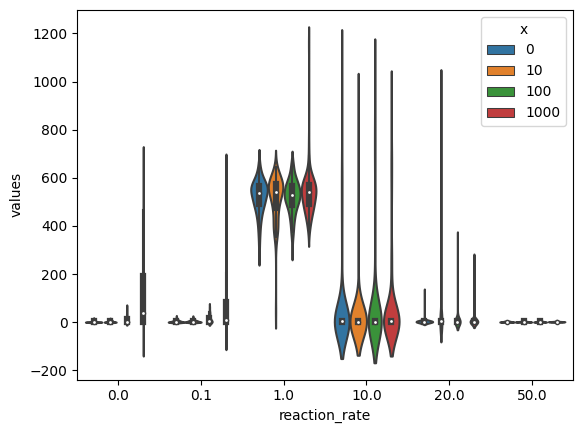

In [ ]:
sns.violinplot(data=df[df['solver']=='stochastic'], x='reaction_rate', y='values', hue='x')

<Axes: xlabel='reaction_rate', ylabel='values'>

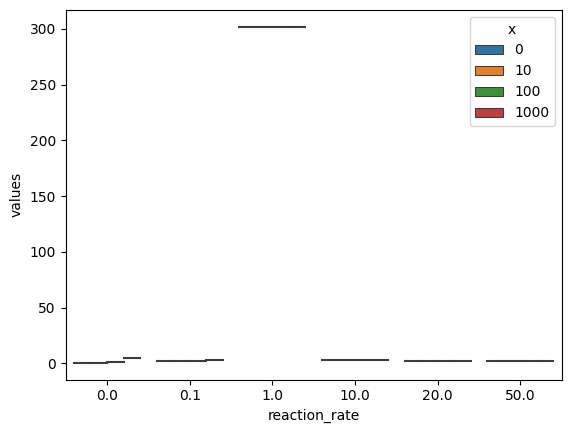

In [ ]:
sns.violinplot(data=df[df['solver']=='ode'], x='reaction_rate', y='values', hue='x')

### How x0-x_final relationship will change depending on the  product concentrations?


In [ ]:
model.get_all_species().keys()

odict_keys(['enhC', 'enhO', 'enhO_enhTF', 'enhTF', 'promC', 'promO', 'promO_promTF', 'promTF', 'prom_enh_complex', 'prom_sil_complex', 'silC', 'silO', 'silO_silTF', 'silTF', 'x'])

In [ ]:
var_results_ss = {0: dict(), 0.1: dict(), 1: dict(), 10: dict(),
                  20: dict(), 50: dict(), 100: dict()}
var_results_ode = {0: dict(), 0.1: dict(), 1: dict(), 10: dict(),
                   20: dict(), 50: dict(), 100: dict()}

def iterate_multiple_values(model):
    for r_val in var_results_ss.keys():
        for x_val in [0, 10, 100, 1000]:
            var_results_ss[r_val][x_val] = model.run(
                solver=solverSSAC, number_of_trajectories=100, variables={
                    'delta': 0.005, 'x': x_val,
                    'enhO': r_val, 'enhO_enhTF': r_val, 'promO': r_val, 'promO_promTF': r_val,
                    'prom_enh_complex': r_val, 'prom_sil_complex': r_val, 'silO': r_val}
                )
            var_results_ode[r_val][x_val] = model.run(
                solver=solverODE, number_of_trajectories=100, variables={
                    'delta': 0.005, 'x': x_val,
                    'enhO': r_val, 'enhO_enhTF': r_val, 'promO': r_val, 'promO_promTF': r_val,
                    'prom_enh_complex': r_val, 'prom_sil_complex': r_val, 'silO': r_val}
                )

iterate_multiple_values(model)

df = {'x': list(), 'product_conc': list(), 'values': list(), 'solver': list()}
for res, solver_name in zip([var_results_ss, var_results_ode], ['stochastic', 'ode']):
    df['solver'] += [solver_name]*2800
    for r_val in var_results_ss.keys(): # len = 2800
        df['product_conc'] += [r_val]*400
        for x_val in [0, 10, 100, 1000]: # len = 400
            x_final = get_the_last(res[r_val][x_val]) # len = 100
            df['x'] += [x_val]*100
            df['values'] += x_final

df = pd.DataFrame(df)

sns.violinplot(data=df[df['solver']=='stochastic'], x='product_conc', y='values', hue='x')

<Axes: xlabel='product_conc', ylabel='values'>

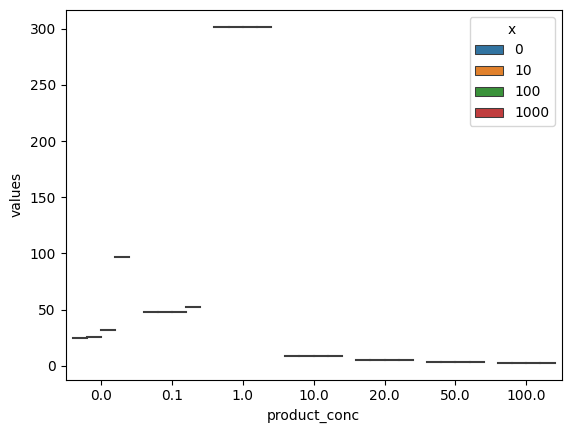

In [ ]:
sns.violinplot(data=df[df['solver']=='ode'], x='product_conc', y='values', hue='x')

Rates = 1 or 0.1, concentrations = 1 or 0.1:

In [ ]:
model.get_all_parameters()

OrderedDict([('bindETF',
              <gillespy2.core.parameter.Parameter at 0x7f1c3d7d5930>),
             ('bindPTF',
              <gillespy2.core.parameter.Parameter at 0x7f1c3d7d58d0>),
             ('bindSTF',
              <gillespy2.core.parameter.Parameter at 0x7f1c3d7d5990>),
             ('delta', <gillespy2.core.parameter.Parameter at 0x7f1c3d7d5ed0>),
             ('kEoff', <gillespy2.core.parameter.Parameter at 0x7f1c3d7d5870>),
             ('kEon', <gillespy2.core.parameter.Parameter at 0x7f1c3d7d5810>),
             ('kPoff', <gillespy2.core.parameter.Parameter at 0x7f1c3d7d56f0>),
             ('kPon', <gillespy2.core.parameter.Parameter at 0x7f1c3d7d5690>),
             ('kSoff', <gillespy2.core.parameter.Parameter at 0x7f1c3d7d57b0>),
             ('kSon', <gillespy2.core.parameter.Parameter at 0x7f1c3d7d5750>),
             ('phi', <gillespy2.core.parameter.Parameter at 0x7f1c3d7d5f30>),
             ('prom_enh_bind',
              <gillespy2.core.parameter.Parame

In [ ]:
var_results_ss = dict()
var_results_ode = dict()

rate01_conc1 = {'delta': 0.005,
                'enhO': 1, 'enhO_enhTF': 1, 'promO': 1, 'promO_promTF': 1,
                'prom_enh_complex': 1, 'prom_sil_complex': 1, 'silO': 1,
                'bindETF': 0.1, 'bindPTF': 0.1, 'bindSTF': 0.1, 'kEon': 0.1,
                'kPon': 0.1, 'kSon': 0.1, 'prom_enh_bind': 0.1, 'prom_sil_bind': 0.1
                }
rate1_conc01 = {'delta': 0.005,
                'enhO': 0.1, 'enhO_enhTF': 0.1, 'promO': 0.1, 'promO_promTF': 0.1,
                'prom_enh_complex': 0.1, 'prom_sil_complex': 0.1, 'silO': 0.1,
                'bindETF': 1, 'bindPTF': 1, 'bindSTF': 1, 'kEon': 1,
                'kPon': 1, 'kSon': 1, 'prom_enh_bind': 1, 'prom_sil_bind': 1
                }
rate01_conc01 = {'delta': 0.005,
                'enhO': 0.1, 'enhO_enhTF': 0.1, 'promO': 0.1, 'promO_promTF': 0.1,
                'prom_enh_complex': 0.1, 'prom_sil_complex': 0.1, 'silO': 0.1,
                'bindETF': 0.1, 'bindPTF': 0.1, 'bindSTF': 0.1, 'kEon': 0.1,
                'kPon': 0.1, 'kSon': 0.1, 'prom_enh_bind': 0.1, 'prom_sil_bind': 0.1
                }

def iterate_multiple_values(model):
    for x_val in [0, 10, 100, 500, 1000, 5000, 10000]:
        rate1_conc01['x'] = x_val
        var_results_ss[x_val] = model.run(
            solver=solverSSAC, number_of_trajectories=100, variables=rate1_conc01
            )
        var_results_ode[x_val] = model.run(
            solver=solverODE, number_of_trajectories=100, variables=rate1_conc01
            )

iterate_multiple_values(model2)

df = {'x': list(), 'values': list(), 'solver': list()}
for res, solver_name in zip([var_results_ss, var_results_ode], ['stochastic', 'ode']):
    df['solver'] += [solver_name]*700
    for x_val in var_results_ss.keys(): # len = 700
        x_final = get_the_last(res[x_val]) # len = 100
        df['x'] += [x_val]*100
        df['values'] += x_final

df = pd.DataFrame(df)

In [ ]:
df.head()

,x,values,solver
0,0,2918.0,stochastic
1,0,2700.0,stochastic
2,0,2596.0,stochastic
3,0,2981.0,stochastic
4,0,3034.0,stochastic


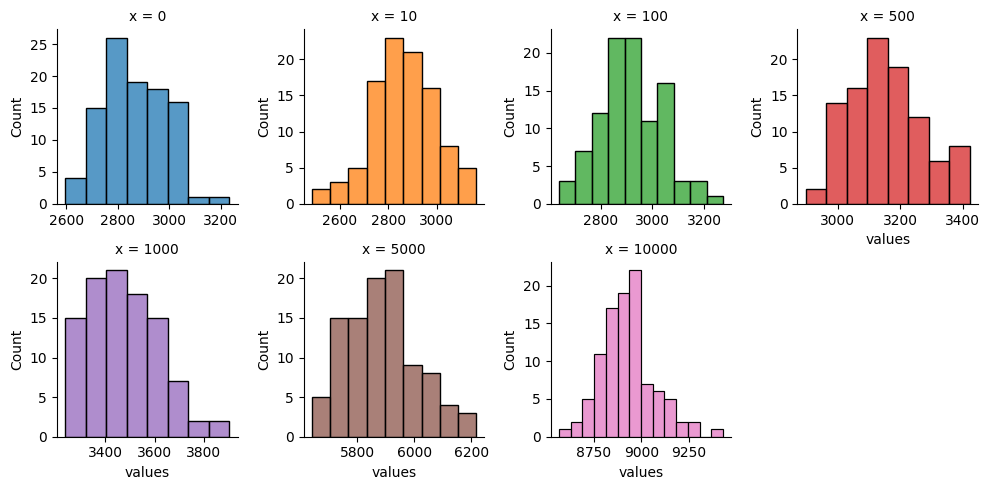

In [ ]:
g = sns.FacetGrid(df[df['solver']=='stochastic'], col="x", hue="x", height=2.5, col_wrap=4, sharex=False, sharey=False)
g.map(sns.histplot, "values")

<Figure size 1000x600 with 0 Axes>

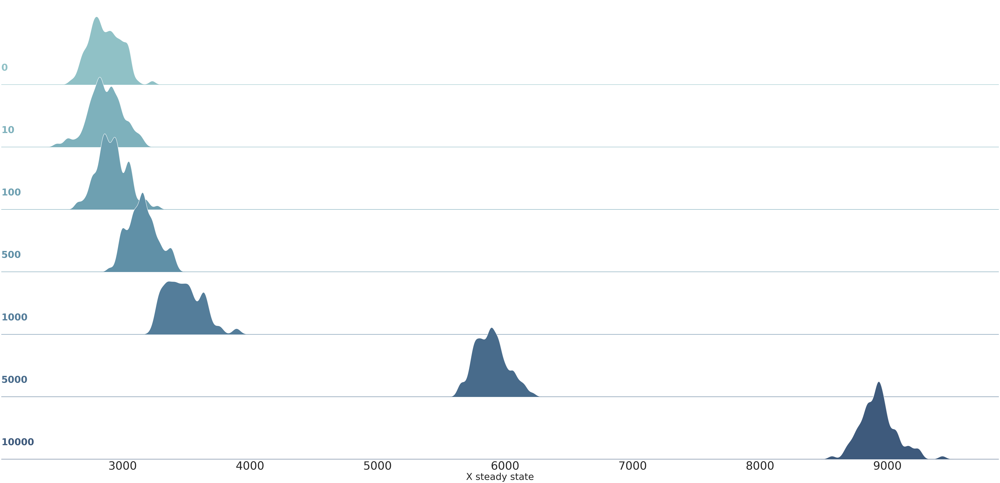

In [ ]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
plt.figure(figsize=(10, 6))

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(df[df['solver']=='stochastic'], row="x", hue="x", aspect=15, height=5, palette=pal)

# Draw the densities in a few steps
g.map(sns.kdeplot, "values",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "values", clip_on=False, color="w", lw=2, bw_adjust=.5)

# passing color=None to refline() uses the hue mapping
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)


# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, 0.2, label, size = 50, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)


g.map(label, "values")

# Set the subplots to overlap
g.figure.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
plt.xticks(fontsize=60)
plt.xlabel("X steady state", fontsize=50)
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)

<Axes: xlabel='x', ylabel='values'>

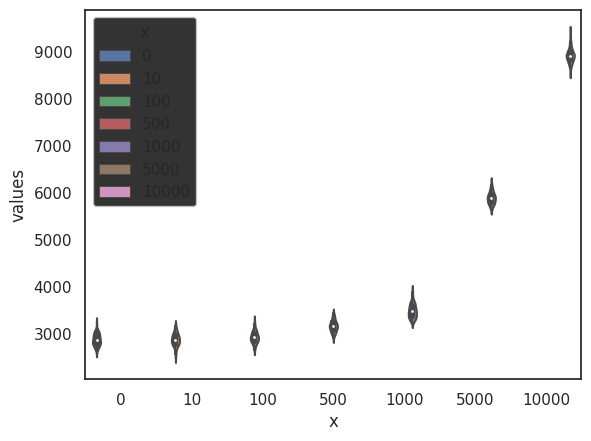

In [ ]:
sns.violinplot(data=df[df['solver']=='stochastic'], x='x', y='values', hue='x')

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:3544: UserWarning: 28.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:3544: UserWarning: 29.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:3544: UserWarning: 32.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:3544: UserWarning: 24.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:3544: UserWarning: 27.0% of the points cannot be plac

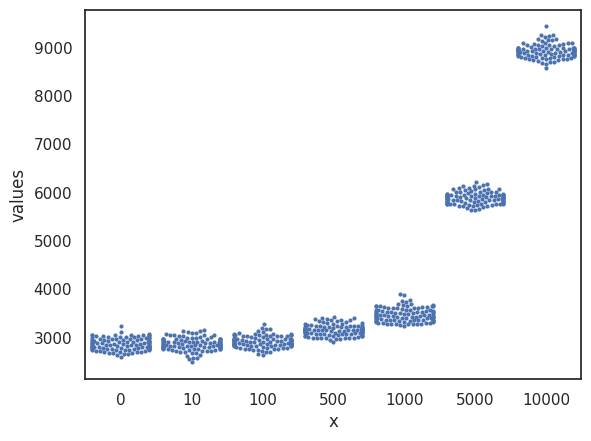

In [ ]:
sns.swarmplot(data=df[df['solver']=='stochastic'], x='x', y='values', size=3);

<Axes: xlabel='x', ylabel='values'>

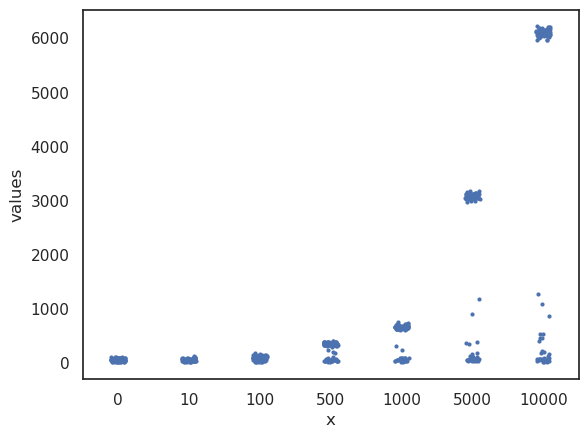

In [ ]:
sns.stripplot(data=df[df['solver']=='stochastic'], x='x', y='values', size=3)

### What if we will add nonlinear rates to the system?

In [ ]:

def create_transcr_model1(parameter_values=None):

    # Instantiate Model
    model = gillespy2.Model(name="eq0")

    # ========================== VARIABLES =================================
    # expression
    rna = gillespy2.Species(name='x', initial_value=1000)

    # enhancer
    enh_open = gillespy2.Species(name='enhO', initial_value=100)
    enh_closed = gillespy2.Species(name='enhC', initial_value=100)
    enh_tf = gillespy2.Species(name='enhTF', initial_value=100)
    enh_complex = gillespy2.Species(name='enhO_enhTF', initial_value=100)

    # silencer
    sil_open = gillespy2.Species(name='silO', initial_value=100)
    sil_closed = gillespy2.Species(name='silC', initial_value=100)
    sil_tf = gillespy2.Species(name='silTF', initial_value=100)
    sil_complex = gillespy2.Species(name='silO_silTF', initial_value=100)

    # promotor
    prom_open = gillespy2.Species(name='promO', initial_value=100)
    prom_closed = gillespy2.Species(name='promC', initial_value=100)
    prom_tf = gillespy2.Species(name='promTF', initial_value=100)
    prom_complex = gillespy2.Species(name='promO_promTF', initial_value=100)

    # interaction promotor - enhancer/silencer
    prom_sil_complex = gillespy2.Species(name='prom_sil_complex', initial_value=100)
    prom_enh_complex = gillespy2.Species(name='prom_enh_complex', initial_value=100)

    # Add Variables to Model
    model.add_species([enh_open, enh_closed, enh_tf, enh_complex,
                       sil_open, sil_closed, sil_tf, sil_complex,
                       prom_open, prom_closed, prom_tf, prom_complex,
                       prom_sil_complex, prom_enh_complex, rna])

    # ========================== PARAMETERS =================================
    # open-closed function
    kPon = gillespy2.Parameter(name='kPon', expression=0.1)
    kPoff = gillespy2.Parameter(name='kPoff', expression=0.1)
    kSon = gillespy2.Parameter(name='kSon', expression=0.1)
    kSoff = gillespy2.Parameter(name='kSoff', expression=0.1)
    kEon = gillespy2.Parameter(name='kEon', expression=0.1)
    kEoff = gillespy2.Parameter(name='kEoff', expression=0.1)

    # TF binding consts
    bindPTF = gillespy2.Parameter(name='bindPTF', expression=0.1)
    bindETF = gillespy2.Parameter(name='bindETF', expression=0.1)
    bindSTF = gillespy2.Parameter(name='bindSTF', expression=0.1)

    unbindPTF = gillespy2.Parameter(name='unbindPTF', expression=0.1)
    unbindETF = gillespy2.Parameter(name='unbindETF', expression=0.1)
    unbindSTF = gillespy2.Parameter(name='unbindSTF', expression=0.1)

    # complex interactions
    prom_enh_bind = gillespy2.Parameter(name='prom_enh_bind', expression=0.3)
    prom_sil_bind = gillespy2.Parameter(name='prom_sil_bind', expression=0.3)
    prom_enh_unbind = gillespy2.Parameter(name='prom_enh_unbind', expression=0.1)
    prom_sil_unbind = gillespy2.Parameter(name='prom_sil_unbind', expression=0.1)

    # amplification, degradation consts
    phi = gillespy2.Parameter(name='phi', expression=5)
    #sole = gillespy2.Parameter(name='phi', expression=1)
    delta = gillespy2.Parameter(name='delta', expression=0.05)

    # Add Parameters to Model
    model.add_parameter([kPon, kPoff, kSon, kSoff, kEon, kEoff,
                         bindPTF, bindETF, bindSTF, unbindPTF, unbindETF, unbindSTF,
                         prom_enh_bind, prom_sil_bind, prom_enh_unbind,
                         prom_sil_unbind, phi, delta])

    ## ========================== REACTIONS =================================
    # open-closed
    Popening = gillespy2.Reaction(name="Popening", rate='kPon', reactants={'promC': 1}, products={'promO':1})
    Pclosing = gillespy2.Reaction(name="Pclosing", rate='kPoff', reactants={'promO': 1}, products={'promC':1})
    Eopening = gillespy2.Reaction(name="Eopening", rate='kEon', reactants={'enhC': 1}, products={'enhO':1})
    Eclosing = gillespy2.Reaction(name="Eclosing", rate='kEoff', reactants={'silO': 1}, products={'silC':1})
    Sopening = gillespy2.Reaction(name="Sopening", rate='kSon', reactants={'enhC': 1}, products={'enhO':1})
    Sclosing = gillespy2.Reaction(name="Sclosing", rate='kSoff', reactants={'enhO': 1}, products={'enhC':1})

    # enh/sil/prom and TFs interaction
    P_TF_binding = gillespy2.Reaction(name="P_TF_binding", rate='bindPTF',
                                      reactants={'promO': 1, 'promTF': 1}, products={'promO_promTF':1})
    E_TF_binding = gillespy2.Reaction(name="E_TF_binding", rate='bindETF',
                                      reactants={'enhO': 1, 'enhTF': 1}, products={'enhO_enhTF':1})
    S_TF_binding = gillespy2.Reaction(name="S_TF_binding", rate='bindSTF',
                                      reactants={'silO': 1, 'silTF': 1}, products={'silO_silTF':1})

    P_TF_unbinding = gillespy2.Reaction(name="P_TF_unbinding", rate='unbindPTF',
                                      reactants={'promO_promTF':1}, products={'promO': 1, 'promTF': 1})
    E_TF_unbinding = gillespy2.Reaction(name="E_TF_unbinding", rate='unbindETF',
                                      reactants={'enhO_enhTF':1}, products={'enhO': 1, 'enhTF': 1})
    S_TF_unbinding = gillespy2.Reaction(name="S_TF_unbinding", rate='unbindSTF',
                                      reactants={'silO_silTF':1}, products={'silO': 1, 'silTF': 1})

    # enh/sil and promotor interaction
    enh_prom_binding = gillespy2.Reaction(name="enh_prom_binding", rate='prom_enh_bind',
                                      reactants={'promO_promTF': 1, 'enhO_enhTF': 1}, products={'prom_enh_complex':1})
    sil_prom_binding = gillespy2.Reaction(name="sil_prom_binding", rate='prom_sil_bind',
                                      reactants={'promO_promTF': 1, 'silO_silTF': 1}, products={'prom_sil_complex':1})

    enh_prom_unbinding = gillespy2.Reaction(name="enh_prom_unbinding", rate='prom_enh_unbind',
                                      reactants={'prom_enh_complex':1}, products={'promO_promTF': 1, 'enhO_enhTF': 1})
    sil_prom_unbinding = gillespy2.Reaction(name="sil_prom_unbinding", rate='prom_sil_unbind',
                                      reactants={'prom_sil_complex':1}, products={'promO_promTF': 1, 'silO_silTF': 1})

    # transcription
    transcr_act = gillespy2.Reaction(name="transcr_act", rate='phi', reactants={'prom_enh_complex': 1}, products={'x':1, 'prom_enh_complex':1}) # 1
    transcr_sil = gillespy2.Reaction(name="transcr_sil", rate='phi', reactants={'prom_sil_complex': 1, 'x': 1}, products={'prom_sil_complex':1})  # 2
    # add defalt transcr promO -->  x? maybe add formula like (promO + prom_enh_complex)
    # how to reflect supressive activity from silencer?
    # somehow reflect that either enh or sil can be bount but not both
    decay = gillespy2.Reaction(name="decay", rate='delta', reactants={'x': 1}, products={})  # 3
    #transcr = gillespy2.Reaction(name="transcr_sil", reactants={},
                     #                products={'x':1}, propensity_function="phi * prom_enh_complex/prom_sil_complex")

    # Add Reactions to Model
    model.add_reaction([Popening, Pclosing, Eopening, Eclosing, Sopening, Sclosing,
                        P_TF_binding, E_TF_binding, S_TF_binding, P_TF_unbinding, E_TF_unbinding, S_TF_unbinding,
                        enh_prom_binding, sil_prom_binding, enh_prom_unbinding, sil_prom_unbinding, transcr_act, transcr_sil, decay]) #

    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)

    # Set Model Timespan
    model.timespan(tspan)
    return model


### Scatterplots

Data generation loop:

In [ ]:
def get_the_last(res):
    # takes the res and returns x for all repetitions
    x = []
    for i in res:
        x.append(i['x'][-1])
    return x

In [ ]:
model = create_transcr_model1()
solverODE = gillespy2.ODECSolver(model, variable=True)
#solverSSAC = gillespy2.SSACSolver(model, variable=True)

#### For constants

In [ ]:
# generating samples with same variable parameters
def iterate_multiple_values(model, solver, n_samples = 2):
    res_dict = {'parameter': [], 'value': [], 'result_s0': [], 'result_s1': []}
    #res_dict['sample'] += [sample]*len(list(model.get_all_parameters().keys()))*300
    for par in list(model.get_all_parameters().keys()):
        res_dict['parameter'] +=  [par]*5*200
        for val in [0.001, 0.1, 1, 10, 100]:
            res_dict['value'] += [val]*200
            tmp_res = model.run(solver=solver, number_of_trajectories=200,
                        variables={par: val})
            tmp_res1 = model.run(solver=solver, number_of_trajectories=200,
                        variables={par: val})
            last, last1 = get_the_last(tmp_res), get_the_last(tmp_res1)
            res_dict[f'result_s0'] += last
            res_dict[f'result_s1'] += last1
    return res_dict

In [ ]:
res_dict = iterate_multiple_values(model, solverODE, n_samples = 2)

In [ ]:
assert len(res_dict['parameter']) == len(res_dict['value']) == len(res_dict['result_s0']) == len(res_dict['result_s1'])

In [ ]:
df = pd.DataFrame(res_dict)
df.head()

Saving dataset:

In [ ]:
df.to_csv('params_for_tiles_precomp_ode.csv')

In [ ]:
df = pd.read_csv('params_for_tiles_precomp.csv')

In [ ]:
df['value'] = df['value'].astype('category')

Plotting:

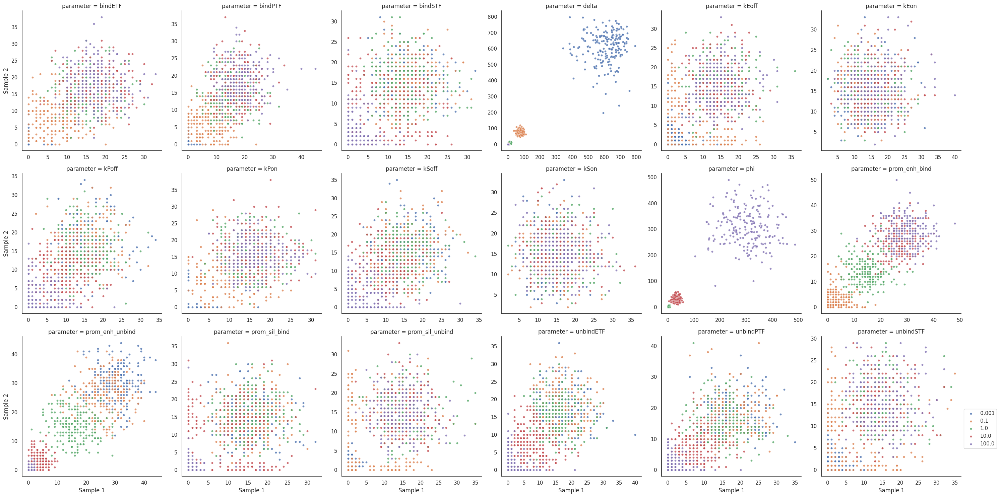

In [ ]:
sns.set_theme(style='white')
# creating a grid
g = sns.FacetGrid(df, col="parameter", hue = 'value', col_wrap=6, height=5,
                  sharex=False, sharey=False)
g.map(sns.scatterplot, "result_s0", "result_s1", alpha=0.8, s=20)
#g.map(sns.kdeplot, "result_s0", "result_s1")
plt.legend(loc='upper left',bbox_to_anchor=(1,0.5))
g.set_axis_labels("Sample 1", "Sample 2")
g.tight_layout()
g.savefig('seaborn_gridplot.png')

In [ ]:
fig = px.scatter(df, x='result_s0', y='result_s1', color='value',
                facet_col='parameter', facet_col_wrap=6,
                 labels={
                    "result_s0": "Sample 1",
                    "result_s1": "Sample 2",
                    "value": "Value of parameters"
                 })
fig.update_traces(marker=dict(size=3))
fig.update_yaxes(matches=None)
fig.update_xaxes(matches=None)
fig.show()

#### For reagents

In [ ]:
# generating samples with same variable parameters
def iterate_multiple_values_r(model, solver):
    res_dict = {'reagent': [], 'value': [], 'result_s0': [], 'result_s1': []}
    #res_dict['sample'] += [sample]*len(list(model.get_all_parameters().keys()))*300
    for par in list(model.get_all_species().keys()):
        res_dict['reagent'] +=  [par]*5*200
        for val in [0.001, 0.1, 1, 10, 100]:
            res_dict['value'] += [val]*200
            tmp_res = model.run(solver=solver, number_of_trajectories=200,
                        variables={par: val})
            tmp_res1 = model.run(solver=solver, number_of_trajectories=200,
                        variables={par: val})
            last, last1 = get_the_last(tmp_res), get_the_last(tmp_res1)
            res_dict[f'result_s0'] += last
            res_dict[f'result_s1'] += last1
    return res_dict

In [ ]:
res_dict = iterate_multiple_values_r(model, solverSSAC)

In [ ]:
assert len(res_dict['reagent']) == len(res_dict['value']) == len(res_dict['result_s0']) == len(res_dict['result_s1'])

In [ ]:
df = pd.DataFrame(res_dict)
df.head()

,reagent,value,result_s0,result_s1
0,enhC,0.001,6.0,12.0
1,enhC,0.001,11.0,4.0
2,enhC,0.001,16.0,15.0
3,enhC,0.001,10.0,8.0
4,enhC,0.001,8.0,13.0


In [ ]:
df.to_csv('reagents_5vals.csv')

In [ ]:
df['value'] = df['value'].astype('category')

In [ ]:
fig = px.scatter(df, x='result_s0', y='result_s1', color='value',
                facet_col='reagent', facet_col_wrap=5,
                 labels={
                    "result_s0": "Sample 1",
                    "result_s1": "Sample 2",
                    "value": "Concentration of reagents"
                 })
fig.update_traces(marker=dict(size=3))
fig.update_yaxes(matches=None)
fig.update_xaxes(matches=None)
fig.show()

## Event modelling

### TF concentration increase

Model definition:

In [ ]:

def create_transcr_model_event(parameter_values=None):

    # Instantiate Model
    model = gillespy2.Model(name="eq0")

    # ========================== VARIABLES =================================
    # expression
    rna = gillespy2.Species(name='x', initial_value=10)

    # enhancer
    enh_open = gillespy2.Species(name='enhO', initial_value=1)
    enh_closed = gillespy2.Species(name='enhC', initial_value=1)
    enh_tf = gillespy2.Species(name='enhTF', initial_value=1)
    enh_complex = gillespy2.Species(name='enhO_enhTF', initial_value=1)

    # silencer
    sil_open = gillespy2.Species(name='silO', initial_value=1)
    sil_closed = gillespy2.Species(name='silC', initial_value=1)
    sil_tf = gillespy2.Species(name='silTF', initial_value=1)
    sil_complex = gillespy2.Species(name='silO_silTF', initial_value=1)

    # promotor
    prom_open = gillespy2.Species(name='promO', initial_value=1)
    prom_closed = gillespy2.Species(name='promC', initial_value=1)
    prom_tf = gillespy2.Species(name='promTF', initial_value=1)
    prom_complex = gillespy2.Species(name='promO_promTF', initial_value=1)

    # interaction promotor - enhancer/silencer
    prom_sil_complex = gillespy2.Species(name='prom_sil_complex', initial_value=1)
    prom_enh_complex = gillespy2.Species(name='prom_enh_complex', initial_value=1)

    # Add Variables to Model
    model.add_species([enh_open, enh_closed, enh_tf, enh_complex,
                       sil_open, sil_closed, sil_tf, sil_complex,
                       prom_open, prom_closed, prom_tf, prom_complex,
                       prom_sil_complex, prom_enh_complex, rna])

    # ========================== PARAMETERS =================================
    # open-closed function
    kPon = gillespy2.Parameter(name='kPon', expression=1)
    kPoff = gillespy2.Parameter(name='kPoff', expression=1)
    kSon = gillespy2.Parameter(name='kSon', expression=1)
    kSoff = gillespy2.Parameter(name='kSoff', expression=1)
    kEon = gillespy2.Parameter(name='kEon', expression=1)
    kEoff = gillespy2.Parameter(name='kEoff', expression=1)

    # TF binding consts
    bindPTF = gillespy2.Parameter(name='bindPTF', expression=1)
    bindETF = gillespy2.Parameter(name='bindETF', expression=1)
    bindSTF = gillespy2.Parameter(name='bindSTF', expression=1)

    unbindPTF = gillespy2.Parameter(name='unbindPTF', expression=1)
    unbindETF = gillespy2.Parameter(name='unbindETF', expression=1)
    unbindSTF = gillespy2.Parameter(name='unbindSTF', expression=1)

    # complex interactions
    prom_enh_bind = gillespy2.Parameter(name='prom_enh_bind', expression=1)
    prom_sil_bind = gillespy2.Parameter(name='prom_sil_bind', expression=1)
    prom_enh_unbind = gillespy2.Parameter(name='prom_enh_unbind', expression=1)
    prom_sil_unbind = gillespy2.Parameter(name='prom_sil_unbind', expression=1)

    # amplification, degradation consts
    phi = gillespy2.Parameter(name='phi', expression=5)
    #sole = gillespy2.Parameter(name='phi', expression=1)
    delta = gillespy2.Parameter(name='delta', expression=0.5)

    # Add Parameters to Model
    model.add_parameter([kPon, kPoff, kSon, kSoff, kEon, kEoff,
                         bindPTF, bindETF, bindSTF, unbindPTF, unbindETF, unbindSTF,
                         prom_enh_bind, prom_sil_bind, prom_enh_unbind,
                         prom_sil_unbind, phi, delta])

    ## ========================== REACTIONS =================================
    # open-closed
    Popening = gillespy2.Reaction(name="Popening", rate='kPon', reactants={'promC': 1}, products={'promO':1})
    Pclosing = gillespy2.Reaction(name="Pclosing", rate='kPoff', reactants={'promO': 1}, products={'promC':1})
    Eopening = gillespy2.Reaction(name="Eopening", rate='kEon', reactants={'enhC': 1}, products={'enhO':1})
    Eclosing = gillespy2.Reaction(name="Eclosing", rate='kEoff', reactants={'silO': 1}, products={'silC':1})
    Sopening = gillespy2.Reaction(name="Sopening", rate='kSon', reactants={'enhC': 1}, products={'enhO':1})
    Sclosing = gillespy2.Reaction(name="Sclosing", rate='kSoff', reactants={'enhO': 1}, products={'enhC':1})

    # enh/sil/prom and TFs interaction
    P_TF_binding = gillespy2.Reaction(name="P_TF_binding", rate='bindPTF',
                                      reactants={'promO': 1, 'promTF': 1}, products={'promO_promTF':1})
    E_TF_binding = gillespy2.Reaction(name="E_TF_binding", rate='bindETF',
                                      reactants={'enhO': 1, 'enhTF': 1}, products={'enhO_enhTF':1})
    S_TF_binding = gillespy2.Reaction(name="S_TF_binding", rate='bindSTF',
                                      reactants={'silO': 1, 'silTF': 1}, products={'silO_silTF':1})

    P_TF_unbinding = gillespy2.Reaction(name="P_TF_unbinding", rate='unbindPTF',
                                      reactants={'promO_promTF':1}, products={'promO': 1, 'promTF': 1})
    E_TF_unbinding = gillespy2.Reaction(name="E_TF_unbinding", rate='unbindETF',
                                      reactants={'enhO_enhTF':1}, products={'enhO': 1, 'enhTF': 1})
    S_TF_unbinding = gillespy2.Reaction(name="S_TF_unbinding", rate='unbindSTF',
                                      reactants={'silO_silTF':1}, products={'silO': 1, 'silTF': 1})

    # enh/sil and promotor interaction
    enh_prom_binding = gillespy2.Reaction(name="enh_prom_binding", rate='prom_enh_bind',
                                      reactants={'promO_promTF': 1, 'enhO_enhTF': 1}, products={'prom_enh_complex':1})
    sil_prom_binding = gillespy2.Reaction(name="sil_prom_binding", rate='prom_sil_bind',
                                      reactants={'promO_promTF': 1, 'silO_silTF': 1}, products={'prom_sil_complex':1})

    enh_prom_unbinding = gillespy2.Reaction(name="enh_prom_unbinding", rate='prom_enh_unbind',
                                      reactants={'prom_enh_complex':1}, products={'promO_promTF': 1, 'enhO_enhTF': 1})
    sil_prom_unbinding = gillespy2.Reaction(name="sil_prom_unbinding", rate='prom_sil_unbind',
                                      reactants={'prom_sil_complex':1}, products={'promO_promTF': 1, 'silO_silTF': 1})

    # transcription
    transcr_act = gillespy2.Reaction(name="transcr_act", rate='phi', reactants={'prom_enh_complex': 1}, products={'x':1, 'prom_enh_complex':1}) # 1
    transcr_sil = gillespy2.Reaction(name="transcr_sil", rate='phi', reactants={'prom_sil_complex': 1, 'x': 1}, products={'prom_sil_complex':1})  # 2
    # add defalt transcr promO -->  x? maybe add formula like (promO + prom_enh_complex)
    # how to reflect supressive activity from silencer?
    # somehow reflect that either enh or sil can be bount but not both
    decay = gillespy2.Reaction(name="decay", rate='delta', reactants={'x': 1}, products={})  # 3
    #transcr = gillespy2.Reaction(name="transcr_sil", reactants={},
                     #                products={'x':1}, propensity_function="phi * prom_enh_complex/prom_sil_complex")

    # Add Reactions to Model
    model.add_reaction([Popening, Pclosing, Eopening, Eclosing, Sopening, Sclosing,
                        P_TF_binding, E_TF_binding, S_TF_binding, P_TF_unbinding, E_TF_unbinding, S_TF_unbinding,
                        enh_prom_binding, sil_prom_binding, enh_prom_unbinding, sil_prom_unbinding, transcr_act, transcr_sil, decay]) #


    ## ========================== EVENTS =================================

    # Define Event Triggers
    et = gillespy2.EventTrigger(expression='t>20')  # when we reach time = 20 perform assignment
    #et2 = gillespy2.EventTrigger(expression='t>30', persistent=True)

    # Define Event Assignments
    ea = gillespy2.EventAssignment(variable='silTF', expression='1000')
    #ea2 = gillespy2.EventAssignment(variable='Sp', expression='100')
    #ea3 = gillespy2.EventAssignment(variable='k1', expression='.1')

    # Define Events
    e = gillespy2.Event(name='silTF_intro', trigger=et, assignments=[ea])
    #e2 = gillespy2.Event(name='event2', trigger=et2, assignments=[ea2, ea3])

    # Add Events to Model
    model.add_event([e])

    ## ========================== TIMESPAN =================================

    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)

    # Set Model Timespan
    model.timespan(tspan)
    return model


Model and solver initialization:

In [ ]:
model_event = create_transcr_model_event()

In [ ]:
model_norm = create_transcr_model1()

Solving and plotting:

In [ ]:
%time results_event = model_event.run(algorithm="Tau-Hybrid", number_of_trajectories=10)

In [ ]:
%time results_norm = model_norm.run(algorithm="Tau-Hybrid", number_of_trajectories=10)

CPU times: user 111 ms, sys: 19 ms, total: 130 ms
Wall time: 14.3 s


In [ ]:
# continuous simulation
for species in model_event.listOfSpecies.values():
        species.mode = 'continuous'

for species in model_norm.listOfSpecies.values():
        species.mode = 'continuous'

cresults_event = model_event.run(algorithm="Tau-Hybrid", number_of_trajectories=10)
cresults_norm = model_norm.run(algorithm="Tau-Hybrid", number_of_trajectories=10)

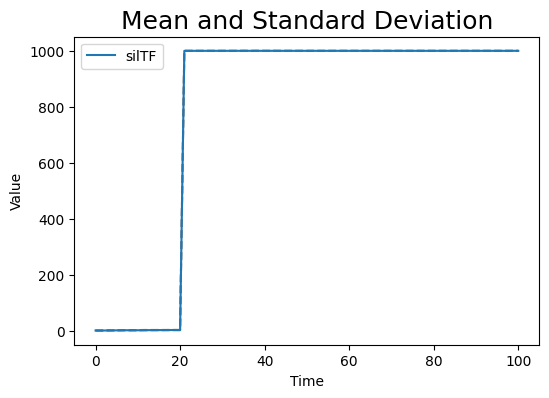

In [ ]:
results_event.plot_mean_stdev(figsize=(6, 4), included_species_list=['silTF'])

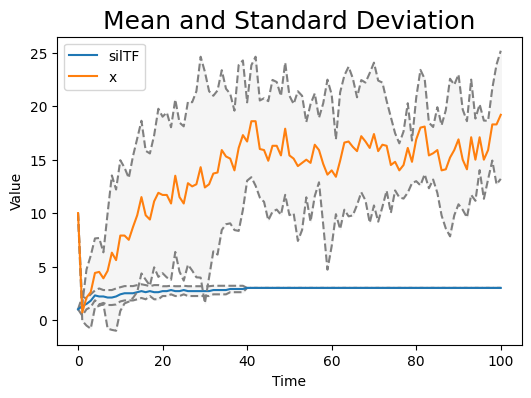

In [ ]:
results_norm.plot_mean_stdev(figsize=(6, 4), included_species_list=['x', 'silTF'])

In [ ]:
cresults.plot()

### Turning on delta later

First, lets try to see trajectories without delta. If there still a drop in the beginning? what time approx we're reaching x0 back?

In [ ]:
def create_transcr_model_wo_delta(parameter_values=None):
    # Instantiate Model
    model = gillespy2.Model(name="eq0")

    # ========================== VARIABLES =================================
    # expression
    rna = gillespy2.Species(name='x', initial_value=10)

    # enhancer
    enh_open = gillespy2.Species(name='enhO', initial_value=1)
    enh_closed = gillespy2.Species(name='enhC', initial_value=1)
    enh_tf = gillespy2.Species(name='enhTF', initial_value=1)
    enh_complex = gillespy2.Species(name='enhO_enhTF', initial_value=1)

    # silencer
    sil_open = gillespy2.Species(name='silO', initial_value=1)
    sil_closed = gillespy2.Species(name='silC', initial_value=1)
    sil_tf = gillespy2.Species(name='silTF', initial_value=1)
    sil_complex = gillespy2.Species(name='silO_silTF', initial_value=1)

    # promotor
    prom_open = gillespy2.Species(name='promO', initial_value=1)
    prom_closed = gillespy2.Species(name='promC', initial_value=1)
    prom_tf = gillespy2.Species(name='promTF', initial_value=1)
    prom_complex = gillespy2.Species(name='promO_promTF', initial_value=1)

    # interaction promotor - enhancer/silencer
    prom_sil_complex = gillespy2.Species(name='prom_sil_complex', initial_value=1)
    prom_enh_complex = gillespy2.Species(name='prom_enh_complex', initial_value=1)

    # Add Variables to Model
    model.add_species([enh_open, enh_closed, enh_tf, enh_complex,
                       sil_open, sil_closed, sil_tf, sil_complex,
                       prom_open, prom_closed, prom_tf, prom_complex,
                       prom_sil_complex, prom_enh_complex, rna])

    # ========================== PARAMETERS =================================
    # open-closed function
    kPon = gillespy2.Parameter(name='kPon', expression=1)
    kPoff = gillespy2.Parameter(name='kPoff', expression=1)
    kSon = gillespy2.Parameter(name='kSon', expression=1)
    kSoff = gillespy2.Parameter(name='kSoff', expression=1)
    kEon = gillespy2.Parameter(name='kEon', expression=1)
    kEoff = gillespy2.Parameter(name='kEoff', expression=1)

    # TF binding consts
    bindPTF = gillespy2.Parameter(name='bindPTF', expression=1)
    bindETF = gillespy2.Parameter(name='bindETF', expression=1)
    bindSTF = gillespy2.Parameter(name='bindSTF', expression=1)

    unbindPTF = gillespy2.Parameter(name='unbindPTF', expression=1)
    unbindETF = gillespy2.Parameter(name='unbindETF', expression=1)
    unbindSTF = gillespy2.Parameter(name='unbindSTF', expression=1)

    # complex interactions
    prom_enh_bind = gillespy2.Parameter(name='prom_enh_bind', expression=1)
    prom_sil_bind = gillespy2.Parameter(name='prom_sil_bind', expression=1)
    prom_enh_unbind = gillespy2.Parameter(name='prom_enh_unbind', expression=1)
    prom_sil_unbind = gillespy2.Parameter(name='prom_sil_unbind', expression=1)

    # amplification, degradation consts
    phi = gillespy2.Parameter(name='phi', expression=5)
    #sole = gillespy2.Parameter(name='phi', expression=1)
    delta = gillespy2.Parameter(name='delta', expression=0)

    # Add Parameters to Model
    model.add_parameter([kPon, kPoff, kSon, kSoff, kEon, kEoff,
                         bindPTF, bindETF, bindSTF, unbindPTF, unbindETF, unbindSTF,
                         prom_enh_bind, prom_sil_bind, prom_enh_unbind,
                         prom_sil_unbind, phi, delta])

    ## ========================== REACTIONS =================================
    # open-closed
    Popening = gillespy2.Reaction(name="Popening", rate='kPon', reactants={'promC': 1}, products={'promO':1})
    Pclosing = gillespy2.Reaction(name="Pclosing", rate='kPoff', reactants={'promO': 1}, products={'promC':1})
    Eopening = gillespy2.Reaction(name="Eopening", rate='kEon', reactants={'enhC': 1}, products={'enhO':1})
    Eclosing = gillespy2.Reaction(name="Eclosing", rate='kEoff', reactants={'silO': 1}, products={'silC':1})
    Sopening = gillespy2.Reaction(name="Sopening", rate='kSon', reactants={'enhC': 1}, products={'enhO':1})
    Sclosing = gillespy2.Reaction(name="Sclosing", rate='kSoff', reactants={'enhO': 1}, products={'enhC':1})

    # enh/sil/prom and TFs interaction
    P_TF_binding = gillespy2.Reaction(name="P_TF_binding", rate='bindPTF',
                                      reactants={'promO': 1, 'promTF': 1}, products={'promO_promTF':1})
    E_TF_binding = gillespy2.Reaction(name="E_TF_binding", rate='bindETF',
                                      reactants={'enhO': 1, 'enhTF': 1}, products={'enhO_enhTF':1})
    S_TF_binding = gillespy2.Reaction(name="S_TF_binding", rate='bindSTF',
                                      reactants={'silO': 1, 'silTF': 1}, products={'silO_silTF':1})

    P_TF_unbinding = gillespy2.Reaction(name="P_TF_unbinding", rate='unbindPTF',
                                      reactants={'promO_promTF':1}, products={'promO': 1, 'promTF': 1})
    E_TF_unbinding = gillespy2.Reaction(name="E_TF_unbinding", rate='unbindETF',
                                      reactants={'enhO_enhTF':1}, products={'enhO': 1, 'enhTF': 1})
    S_TF_unbinding = gillespy2.Reaction(name="S_TF_unbinding", rate='unbindSTF',
                                      reactants={'silO_silTF':1}, products={'silO': 1, 'silTF': 1})

    # enh/sil and promotor interaction
    enh_prom_binding = gillespy2.Reaction(name="enh_prom_binding", rate='prom_enh_bind',
                                      reactants={'promO_promTF': 1, 'enhO_enhTF': 1}, products={'prom_enh_complex':1})
    sil_prom_binding = gillespy2.Reaction(name="sil_prom_binding", rate='prom_sil_bind',
                                      reactants={'promO_promTF': 1, 'silO_silTF': 1}, products={'prom_sil_complex':1})

    enh_prom_unbinding = gillespy2.Reaction(name="enh_prom_unbinding", rate='prom_enh_unbind',
                                      reactants={'prom_enh_complex':1}, products={'promO_promTF': 1, 'enhO_enhTF': 1})
    sil_prom_unbinding = gillespy2.Reaction(name="sil_prom_unbinding", rate='prom_sil_unbind',
                                      reactants={'prom_sil_complex':1}, products={'promO_promTF': 1, 'silO_silTF': 1})

    # transcription
    transcr_act = gillespy2.Reaction(name="transcr_act", rate='phi', reactants={'prom_enh_complex': 1}, products={'x':1, 'prom_enh_complex':1}) # 1
    transcr_sil = gillespy2.Reaction(name="transcr_sil", rate='phi', reactants={'prom_sil_complex': 1, 'x': 1}, products={'prom_sil_complex':1})  # 2
    # add defalt transcr promO -->  x? maybe add formula like (promO + prom_enh_complex)
    # how to reflect supressive activity from silencer?
    # somehow reflect that either enh or sil can be bount but not both
    decay = gillespy2.Reaction(name="decay", rate='delta', reactants={'x': 1}, products={})  # 3
    #transcr = gillespy2.Reaction(name="transcr_sil", reactants={},
                     #                products={'x':1}, propensity_function="phi * prom_enh_complex/prom_sil_complex")

    # Add Reactions to Model
    model.add_reaction([Popening, Pclosing, Eopening, Eclosing, Sopening, Sclosing,
                        P_TF_binding, E_TF_binding, S_TF_binding, P_TF_unbinding, E_TF_unbinding, S_TF_unbinding,
                        enh_prom_binding, sil_prom_binding, enh_prom_unbinding, sil_prom_unbinding, transcr_act, transcr_sil, decay])

    ## ========================== TIMESPAN =================================

    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)

    # Set Model Timespan
    model.timespan(tspan)
    return model


In [ ]:
model_wo_delta = create_transcr_model_wo_delta()
solverSSAC = gillespy2.SSACSolver(model_wo_delta)
solverODE = gillespy2.ODECSolver(model_wo_delta)
res_ssa = model_wo_delta.run(solver=solverSSAC, number_of_trajectories=100)
res_ode = model_wo_delta.run(solver=solverODE, number_of_trajectories=100)

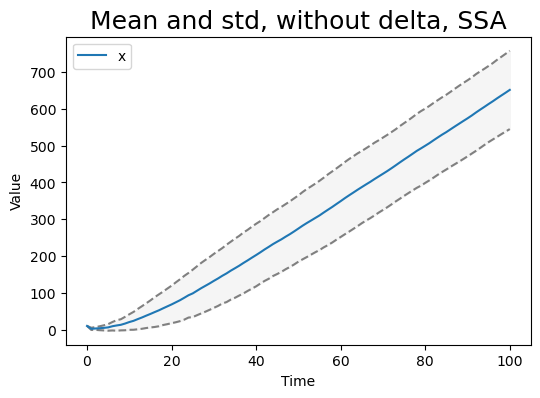

In [ ]:
res_ssa.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'],
                       show_title=True, title=f'Mean and std, without delta, SSA')

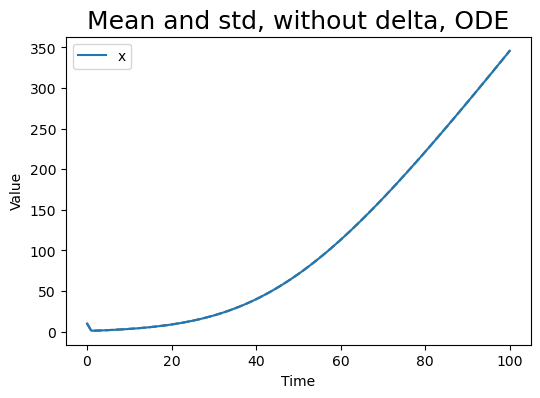

In [ ]:
res_ode.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'],
                       show_title=True, title=f'Mean and std, without delta, ODE')

Now we can model the event of turning on (low!) delta around 20 timepoints after the start

In [ ]:
def create_transcr_delta_event(parameter_values=None):

    # Instantiate Model
    model = gillespy2.Model(name="eq0")

    # ========================== VARIABLES =================================
    # expression
    rna = gillespy2.Species(name='x', initial_value=10)

    # enhancer
    enh_open = gillespy2.Species(name='enhO', initial_value=1)
    enh_closed = gillespy2.Species(name='enhC', initial_value=1)
    enh_tf = gillespy2.Species(name='enhTF', initial_value=1)
    enh_complex = gillespy2.Species(name='enhO_enhTF', initial_value=1)

    # silencer
    sil_open = gillespy2.Species(name='silO', initial_value=1)
    sil_closed = gillespy2.Species(name='silC', initial_value=1)
    sil_tf = gillespy2.Species(name='silTF', initial_value=1)
    sil_complex = gillespy2.Species(name='silO_silTF', initial_value=1)

    # promotor
    prom_open = gillespy2.Species(name='promO', initial_value=1)
    prom_closed = gillespy2.Species(name='promC', initial_value=1)
    prom_tf = gillespy2.Species(name='promTF', initial_value=1)
    prom_complex = gillespy2.Species(name='promO_promTF', initial_value=1)

    # interaction promotor - enhancer/silencer
    prom_sil_complex = gillespy2.Species(name='prom_sil_complex', initial_value=1)
    prom_enh_complex = gillespy2.Species(name='prom_enh_complex', initial_value=1)

    # Add Variables to Model
    model.add_species([enh_open, enh_closed, enh_tf, enh_complex,
                       sil_open, sil_closed, sil_tf, sil_complex,
                       prom_open, prom_closed, prom_tf, prom_complex,
                       prom_sil_complex, prom_enh_complex, rna])

    # ========================== PARAMETERS =================================
    # open-closed function
    kPon = gillespy2.Parameter(name='kPon', expression=1)
    kPoff = gillespy2.Parameter(name='kPoff', expression=1)
    kSon = gillespy2.Parameter(name='kSon', expression=1)
    kSoff = gillespy2.Parameter(name='kSoff', expression=1)
    kEon = gillespy2.Parameter(name='kEon', expression=1)
    kEoff = gillespy2.Parameter(name='kEoff', expression=1)

    # TF binding consts
    bindPTF = gillespy2.Parameter(name='bindPTF', expression=1)
    bindETF = gillespy2.Parameter(name='bindETF', expression=1)
    bindSTF = gillespy2.Parameter(name='bindSTF', expression=1)

    unbindPTF = gillespy2.Parameter(name='unbindPTF', expression=1)
    unbindETF = gillespy2.Parameter(name='unbindETF', expression=1)
    unbindSTF = gillespy2.Parameter(name='unbindSTF', expression=1)

    # complex interactions
    prom_enh_bind = gillespy2.Parameter(name='prom_enh_bind', expression=1)
    prom_sil_bind = gillespy2.Parameter(name='prom_sil_bind', expression=1)
    prom_enh_unbind = gillespy2.Parameter(name='prom_enh_unbind', expression=1)
    prom_sil_unbind = gillespy2.Parameter(name='prom_sil_unbind', expression=1)

    # amplification, degradation consts
    phi = gillespy2.Parameter(name='phi', expression=5)
    #sole = gillespy2.Parameter(name='phi', expression=1)
    delta = gillespy2.Parameter(name='delta', expression=0)

    # Add Parameters to Model
    model.add_parameter([kPon, kPoff, kSon, kSoff, kEon, kEoff,
                         bindPTF, bindETF, bindSTF, unbindPTF, unbindETF, unbindSTF,
                         prom_enh_bind, prom_sil_bind, prom_enh_unbind,
                         prom_sil_unbind, phi, delta])

    ## ========================== REACTIONS =================================
    # open-closed
    Popening = gillespy2.Reaction(name="Popening", rate='kPon', reactants={'promC': 1}, products={'promO':1})
    Pclosing = gillespy2.Reaction(name="Pclosing", rate='kPoff', reactants={'promO': 1}, products={'promC':1})
    Eopening = gillespy2.Reaction(name="Eopening", rate='kEon', reactants={'enhC': 1}, products={'enhO':1})
    Eclosing = gillespy2.Reaction(name="Eclosing", rate='kEoff', reactants={'silO': 1}, products={'silC':1})
    Sopening = gillespy2.Reaction(name="Sopening", rate='kSon', reactants={'enhC': 1}, products={'enhO':1})
    Sclosing = gillespy2.Reaction(name="Sclosing", rate='kSoff', reactants={'enhO': 1}, products={'enhC':1})

    # enh/sil/prom and TFs interaction
    P_TF_binding = gillespy2.Reaction(name="P_TF_binding", rate='bindPTF',
                                      reactants={'promO': 1, 'promTF': 1}, products={'promO_promTF':1})
    E_TF_binding = gillespy2.Reaction(name="E_TF_binding", rate='bindETF',
                                      reactants={'enhO': 1, 'enhTF': 1}, products={'enhO_enhTF':1})
    S_TF_binding = gillespy2.Reaction(name="S_TF_binding", rate='bindSTF',
                                      reactants={'silO': 1, 'silTF': 1}, products={'silO_silTF':1})

    P_TF_unbinding = gillespy2.Reaction(name="P_TF_unbinding", rate='unbindPTF',
                                      reactants={'promO_promTF':1}, products={'promO': 1, 'promTF': 1})
    E_TF_unbinding = gillespy2.Reaction(name="E_TF_unbinding", rate='unbindETF',
                                      reactants={'enhO_enhTF':1}, products={'enhO': 1, 'enhTF': 1})
    S_TF_unbinding = gillespy2.Reaction(name="S_TF_unbinding", rate='unbindSTF',
                                      reactants={'silO_silTF':1}, products={'silO': 1, 'silTF': 1})

    # enh/sil and promotor interaction
    enh_prom_binding = gillespy2.Reaction(name="enh_prom_binding", rate='prom_enh_bind',
                                      reactants={'promO_promTF': 1, 'enhO_enhTF': 1}, products={'prom_enh_complex':1})
    sil_prom_binding = gillespy2.Reaction(name="sil_prom_binding", rate='prom_sil_bind',
                                      reactants={'promO_promTF': 1, 'silO_silTF': 1}, products={'prom_sil_complex':1})

    enh_prom_unbinding = gillespy2.Reaction(name="enh_prom_unbinding", rate='prom_enh_unbind',
                                      reactants={'prom_enh_complex':1}, products={'promO_promTF': 1, 'enhO_enhTF': 1})
    sil_prom_unbinding = gillespy2.Reaction(name="sil_prom_unbinding", rate='prom_sil_unbind',
                                      reactants={'prom_sil_complex':1}, products={'promO_promTF': 1, 'silO_silTF': 1})

    # transcription
    transcr_act = gillespy2.Reaction(name="transcr_act", rate='phi', reactants={'prom_enh_complex': 1}, products={'x':1, 'prom_enh_complex':1}) # 1
    transcr_sil = gillespy2.Reaction(name="transcr_sil", rate='phi', reactants={'prom_sil_complex': 1, 'x': 1}, products={'prom_sil_complex':1})  # 2
    # add defalt transcr promO -->  x? maybe add formula like (promO + prom_enh_complex)
    # how to reflect supressive activity from silencer?
    # somehow reflect that either enh or sil can be bount but not both
    decay = gillespy2.Reaction(name="decay", rate='delta', reactants={'x': 1}, products={})  # 3
    #transcr = gillespy2.Reaction(name="transcr_sil", reactants={},
                     #                products={'x':1}, propensity_function="phi * prom_enh_complex/prom_sil_complex")

    # Add Reactions to Model
    model.add_reaction([Popening, Pclosing, Eopening, Eclosing, Sopening, Sclosing,
                        P_TF_binding, E_TF_binding, S_TF_binding, P_TF_unbinding, E_TF_unbinding, S_TF_unbinding,
                        enh_prom_binding, sil_prom_binding, enh_prom_unbinding, sil_prom_unbinding, transcr_act, transcr_sil, decay]) #


    ## ========================== EVENTS =================================

    # Define Event Triggers
    et = gillespy2.EventTrigger(expression='t>20')  # when we reach time = 20 perform assignment
    #et2 = gillespy2.EventTrigger(expression='t>30', persistent=True)

    # Define Event Assignments
    ea = gillespy2.EventAssignment(variable='delta', expression='0.005')
    #ea2 = gillespy2.EventAssignment(variable='Sp', expression='100')
    #ea3 = gillespy2.EventAssignment(variable='k1', expression='.1')

    # Define Events
    e = gillespy2.Event(name='delta_on', trigger=et, assignments=[ea])
    #e2 = gillespy2.Event(name='event2', trigger=et2, assignments=[ea2, ea3])

    # Add Events to Model
    model.add_event([e])

    ## ========================== TIMESPAN =================================

    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)

    # Set Model Timespan
    model.timespan(tspan)
    return model


Our default model with delta = 0.5:

In [ ]:
model = create_transcr_model1()
results= model.run(algorithm="Tau-Hybrid", number_of_trajectories=100)

# continuous simulation
for species in model.listOfSpecies.values():
        species.mode = 'continuous'

cresults = model.run(algorithm="Tau-Hybrid", number_of_trajectories=100)

New models:

In [ ]:
model_delta20 = create_transcr_delta_event()
results_event = model_delta20.run(algorithm="Tau-Hybrid", number_of_trajectories=100)
results_norm = model_wo_delta.run(algorithm="Tau-Hybrid", number_of_trajectories=100)

# continuous simulation
for species in model_delta20.listOfSpecies.values():
        species.mode = 'continuous'

for species in model_wo_delta.listOfSpecies.values():
        species.mode = 'continuous'

cresults_event = model_delta20.run(algorithm="Tau-Hybrid", number_of_trajectories=100)
cresults_norm = model_wo_delta.run(algorithm="Tau-Hybrid", number_of_trajectories=100)
#results_event.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'])
#results_norm.plot_mean_stdev(figsize=(6, 4), included_species_list=['x'])

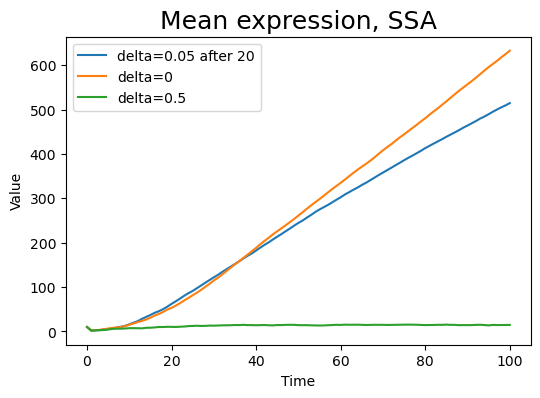

In [ ]:
plt.style.use("default")
plt.figure(figsize=(6, 4))

avg_event = results_event.average_ensemble().data[0]
plt.plot(avg_event['time'], avg_event['x'], label='delta=0.05 after 20')
avg_delta0 = results_norm.average_ensemble().data[0]
plt.plot(avg_delta0['time'], avg_delta0['x'], label='delta=0')
avg_def = results.average_ensemble().data[0]
plt.plot(avg_def['time'], avg_def['x'], label='delta=0.5')

plt.title(f'Mean expression, SSA', fontsize=18)
plt.xlabel("Time")
plt.ylabel("Value")
plt.legend(loc='upper left')

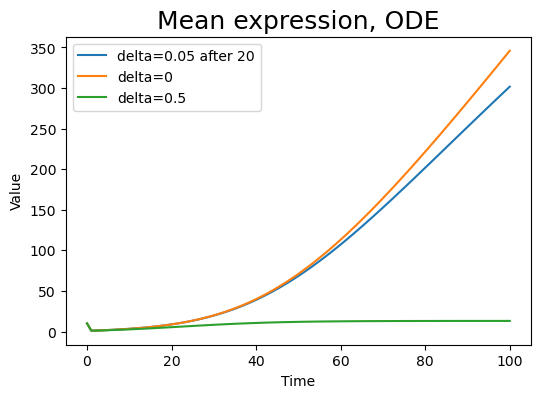

In [ ]:
plt.style.use("default")
plt.figure(figsize=(6, 4))

avg_event = cresults_event.average_ensemble().data[0]
plt.plot(avg_event['time'], avg_event['x'], label='delta=0.05 after 20')
avg_delta0 = cresults_norm.average_ensemble().data[0]
plt.plot(avg_delta0['time'], avg_delta0['x'], label='delta=0')
avg_def = cresults.average_ensemble().data[0]
plt.plot(avg_def['time'], avg_def['x'], label='delta=0.5')

plt.title(f'Mean expression, ODE', fontsize=18)
plt.xlabel("Time")
plt.ylabel("Value")
plt.legend(loc='upper left')

## Adding the TF cooperativity:

In [ ]:

def create_transcr_model1(parameter_values=None):

    # Instantiate Model
    model = gillespy2.Model(name="eq0")

    # ========================== VARIABLES =================================
    # expression
    rna = gillespy2.Species(name='x', initial_value=10)

    # enhancer
    enh_open = gillespy2.Species(name='enhO', initial_value=1)
    enh_closed = gillespy2.Species(name='enhC', initial_value=1)
    enh_tf = gillespy2.Species(name='enhTF', initial_value=1)
    enh_complex = gillespy2.Species(name='enhO_enhTF', initial_value=1)

    # silencer
    sil_open = gillespy2.Species(name='silO', initial_value=1)
    sil_closed = gillespy2.Species(name='silC', initial_value=1)
    sil_tf = gillespy2.Species(name='silTF', initial_value=1)
    sil_complex = gillespy2.Species(name='silO_silTF', initial_value=1)

    # promotor
    prom_open = gillespy2.Species(name='promO', initial_value=1)
    prom_closed = gillespy2.Species(name='promC', initial_value=1)
    prom_tf = gillespy2.Species(name='promTF', initial_value=1)
    prom_complex = gillespy2.Species(name='promO_promTF', initial_value=1)

    # interaction promotor - enhancer/silencer
    prom_sil_complex = gillespy2.Species(name='prom_sil_complex', initial_value=1)
    prom_enh_complex = gillespy2.Species(name='prom_enh_complex', initial_value=1)

    # Add Variables to Model
    model.add_species([enh_open, enh_closed, enh_tf, enh_complex,
                       sil_open, sil_closed, sil_tf, sil_complex,
                       prom_open, prom_closed, prom_tf, prom_complex,
                       prom_sil_complex, prom_enh_complex, rna])

    # ========================== PARAMETERS =================================
    # open-closed function
    kPon = gillespy2.Parameter(name='kPon', expression=1)
    kPoff = gillespy2.Parameter(name='kPoff', expression=1)
    kSon = gillespy2.Parameter(name='kSon', expression=1)
    kSoff = gillespy2.Parameter(name='kSoff', expression=1)
    kEon = gillespy2.Parameter(name='kEon', expression=1)
    kEoff = gillespy2.Parameter(name='kEoff', expression=1)

    # TF binding consts
    bindPTF = gillespy2.Parameter(name='bindPTF', expression=1)
    bindETF = gillespy2.Parameter(name='bindETF', expression=1)
    bindSTF = gillespy2.Parameter(name='bindSTF', expression=1)

    unbindPTF = gillespy2.Parameter(name='unbindPTF', expression=1)
    unbindETF = gillespy2.Parameter(name='unbindETF', expression=1)
    unbindSTF = gillespy2.Parameter(name='unbindSTF', expression=1)

    # complex interactions
    prom_enh_bind = gillespy2.Parameter(name='prom_enh_bind', expression=1)
    prom_sil_bind = gillespy2.Parameter(name='prom_sil_bind', expression=1)
    prom_enh_unbind = gillespy2.Parameter(name='prom_enh_unbind', expression=1)
    prom_sil_unbind = gillespy2.Parameter(name='prom_sil_unbind', expression=1)

    # amplification, degradation consts
    phi = gillespy2.Parameter(name='phi', expression=5)
    #sole = gillespy2.Parameter(name='phi', expression=1)
    delta = gillespy2.Parameter(name='delta', expression=0.5)

    # Add Parameters to Model
    model.add_parameter([kPon, kPoff, kSon, kSoff, kEon, kEoff,
                         bindPTF, bindETF, bindSTF, unbindPTF, unbindETF, unbindSTF,
                         prom_enh_bind, prom_sil_bind, prom_enh_unbind,
                         prom_sil_unbind, phi, delta])

    ## ========================== REACTIONS =================================
    # open-closed
    Popening = gillespy2.Reaction(name="Popening", rate='kPon', reactants={'promC': 1}, products={'promO':1})
    Pclosing = gillespy2.Reaction(name="Pclosing", rate='kPoff', reactants={'promO': 1}, products={'promC':1})
    Eopening = gillespy2.Reaction(name="Eopening", rate='kEon', reactants={'enhC': 1}, products={'enhO':1})
    Eclosing = gillespy2.Reaction(name="Eclosing", rate='kEoff', reactants={'silO': 1}, products={'silC':1})
    Sopening = gillespy2.Reaction(name="Sopening", rate='kSon', reactants={'enhC': 1}, products={'enhO':1})
    Sclosing = gillespy2.Reaction(name="Sclosing", rate='kSoff', reactants={'enhO': 1}, products={'enhC':1})

    # enh/sil/prom and TFs interaction
    P_TF_binding = gillespy2.Reaction(name="P_TF_binding", rate='bindPTF',
                                      reactants={'promO': 1, 'promTF': 1}, products={'promO_promTF':1})
    E_TF_binding = gillespy2.Reaction(name="E_TF_binding", rate='bindETF',
                                      reactants={'enhO': 1, 'enhTF': 1}, products={'enhO_enhTF':1})
    S_TF_binding = gillespy2.Reaction(name="S_TF_binding", rate='bindSTF',
                                      reactants={'silO': 1, 'silTF': 1}, products={'silO_silTF':1})

    P_TF_unbinding = gillespy2.Reaction(name="P_TF_unbinding", rate='unbindPTF',
                                      reactants={'promO_promTF':1}, products={'promO': 1, 'promTF': 1})
    E_TF_unbinding = gillespy2.Reaction(name="E_TF_unbinding", rate='unbindETF',
                                      reactants={'enhO_enhTF':1}, products={'enhO': 1, 'enhTF': 1})
    S_TF_unbinding = gillespy2.Reaction(name="S_TF_unbinding", rate='unbindSTF',
                                      reactants={'silO_silTF':1}, products={'silO': 1, 'silTF': 1})

    # enh/sil and promotor interaction
    enh_prom_binding = gillespy2.Reaction(name="enh_prom_binding", rate='prom_enh_bind',
                                      reactants={'promO_promTF': 1, 'enhO_enhTF': 1}, products={'prom_enh_complex':1})
    sil_prom_binding = gillespy2.Reaction(name="sil_prom_binding", rate='prom_sil_bind',
                                      reactants={'promO_promTF': 1, 'silO_silTF': 1}, products={'prom_sil_complex':1})

    enh_prom_unbinding = gillespy2.Reaction(name="enh_prom_unbinding", rate='prom_enh_unbind',
                                      reactants={'prom_enh_complex':1}, products={'promO_promTF': 1, 'enhO_enhTF': 1})
    sil_prom_unbinding = gillespy2.Reaction(name="sil_prom_unbinding", rate='prom_sil_unbind',
                                      reactants={'prom_sil_complex':1}, products={'promO_promTF': 1, 'silO_silTF': 1})

    # transcription
    transcr_act = gillespy2.Reaction(name="transcr_act", rate='phi', reactants={'prom_enh_complex': 1}, products={'x':1, 'prom_enh_complex':1}) # 1
    transcr_sil = gillespy2.Reaction(name="transcr_sil", rate='phi', reactants={'prom_sil_complex': 1, 'x': 1}, products={'prom_sil_complex':1})  # 2
    # add defalt transcr promO -->  x? maybe add formula like (promO + prom_enh_complex)
    # how to reflect supressive activity from silencer?
    # somehow reflect that either enh or sil can be bount but not both
    decay = gillespy2.Reaction(name="decay", rate='delta', reactants={'x': 1}, products={})  # 3
    #transcr = gillespy2.Reaction(name="transcr_sil", reactants={},
                     #                products={'x':1}, propensity_function="phi * prom_enh_complex/prom_sil_complex")

    # Add Reactions to Model
    model.add_reaction([Popening, Pclosing, Eopening, Eclosing, Sopening, Sclosing,
                        P_TF_binding, E_TF_binding, S_TF_binding, P_TF_unbinding, E_TF_unbinding, S_TF_unbinding,
                        enh_prom_binding, sil_prom_binding, enh_prom_unbinding, sil_prom_unbinding, transcr_act, transcr_sil, decay]) #

    # Define Timespan
    tspan = gillespy2.TimeSpan.linspace(t=100, num_points=101)

    # Set Model Timespan
    model.timespan(tspan)
    return model
,